In [1]:
import os
import pandas as pd
os.chdir("/home/adrianhurtado/testing/post_watoc/august")
from madnessReader import MadnessReader
from madnessReader import ExcitedData
from madnessReader import FrequencyData
from madnessReader import *
from daltonRunner import DaltonRunner
import matplotlib.pyplot as plt
import json
import seaborn as sns


# Basis Set Information

# Dunning type and Karlsruhe-type

- **cc-pVXZ**
    - Correlation consistent (cc)
    - Accurate ground-state energies for correlated methods
- **aug-cc-pVXZ**
    - Provides additional diffuse functions through augmentation
    - augmentation (aug)
- **d-aug-cc-pVXZ**
    - Furche and Rapport
    - optimized for response properties for DFT applications based on static polarizability calculations
    - (double augmented)
- **d-aug-cc-pCVXZ**
    - Polarized core (pC)
    - additional angular moment functions in the core electrons
    - AFAIK- Important for 1st and 2nd group elements where inner electrons are easily polarized
        - Na,Li,Mg
        
- **MRA** Multiresolution Multiwavelet basis
    - Functions represented on adaptive grid
    - Not optimized in any physical situtation but flexible enough to represent all physical situations
    - Optimal basis is constructed throughout the solution of the equations. 
        - Flexible for consistently accurate solution for all potentials and all molecules
    - Increase in accuracy comes at a cost
        - larger prefactor therfore slower for small molecules
    - Better scaling therefore large molecules should be possible wi
    
    
## Some additional basis-sets

- **aug-cc-pCTZ**
    -TZP Triple Zeta + Polarization + Tight Core + Diffuse



In [2]:
# list all the basis-sets that we are using

basis_list=['aug-cc-pVDZ','aug-cc-pVTZ','aug-cc-pVQZ','aug-cc-pV5Z','aug-cc-pV6Z']
d_basis_list=['d-aug-cc-pVDZ','d-aug-cc-pVTZ','d-aug-cc-pVQZ','d-aug-cc-pV5Z','d-aug-cc-pV6Z']
pc_basis_list=['aug-cc-pCVDZ','aug-cc-pCVTZ','aug-cc-pCVQZ']
dpc_basis_list=['d-aug-cc-pCVDZ','d-aug-cc-pCVTZ','d-aug-cc-pCVQZ']
# dalton does not have these yet... perhaps I can add them
#pwcv_basis_list=['aug-cc-pCVDZ','aug-cc-pCVTZ','aug-cc-pCVQZ']

In [3]:
all_mols=[]
for g in glob.glob('molecules/*.mol'):
    m = g.split('/')
    mol = m[1].split('.')[0]
    all_mols.append(mol)
print(all_mols)       
print(len(all_mols))     


['CSO', 'LiH', 'FCN', 'P2H4', 'OCl2', 'LiH_s', 'SH2', 'Li2', 'NaCl', 'C2H2', 'BH3', 'HCONH2', 'CH3SH', 'P2', 'BH2Cl', 'NaCN', 'HCN', 'CH3OH', 'HBS', 'C2H4', 'SO2', 'HNC', 'Na2', 'F2', 'N2', 'SiH4', 'N2H2', 'CH3NH2', 'NH3O', 'HOF', 'He', 'HF', 'OF2', 'ClF', 'HCOOH', 'NH3', 'CH3Cl', 'Mg2', 'N2H4', 'Ne', 'HCHO', 'SiH3Cl', 'SF2', 'SiH3F', 'HOCl', 'HOOH', 'H2', 'HCl', 'HCCF', 'Mg', 'CH2BH', 'CH3BH2', 'BF', 'SiO', 'FNO', 'H2O', 'S2H2', 'LiCl', 'PH3O', 'Ar', 'BHF2', 'HNS', 'O3', 'HBO', 'Cl2', 'C6H6', 'NH2Cl', 'LiCN', 'CO', 'CS', 'LiBH4', 'CH4', 'BeH2', 'BH2F', 'CH2NH', 'CH3F', 'CO2', 'PH3', 'ClCN', 'HCHS', 'NaLi', 'SCl2', 'Be', 'NH2OH', 'HCCCl', 'NaH', 'NH2F', 'HNO', 'HCP', 'NOCl']
90


In [4]:
def polar_data_summary(mol,xc,op,compare_basis):
    
    d=display_convergence_plots(mol,xc,op,True )
    d=frequency_norm_plots(mol,xc,op,True )
    data=FrequencyData(mol,xc,op)
    gd,rd,md,dd=data.compare_dalton(compare_basis)
    #display('madness',md.round(4))
    #display(compare_basis,rd.round(4))
    display('[madness]-['+compare_basis+']',dd.round(4))
    avg_error=dd.loc[:,['xx','yy','zz']].mean(1)
    display('error in avg polarizability compared to:'+compare_basis,avg_error)
    return avg_error
def compare_basis(mol,xc,op,basis_list):
    data=FrequencyData(mol,xc,op)
    #display('madness',md.round(4))
    #display(compare_basis,rd.round(4))
    b_error={}
    for basis in basis_list:
        gd,rd,md,dd=data.compare_dalton(basis)
        avg_error=dd.loc[:,['xx','yy','zz']].mean(1)
        b_error[basis]=avg_error
    return pd.DataFrame(b_error)

def report_converged(mol_list,num_converged):
    converged=[]
    not_converged=[]
    not_found=[]
    type_error=[]
    json_error=[]
    for mol in mol_list:
        try:
            ben=FrequencyData(mol,'hf','dipole')
            if ben.converged.all() and ben.converged.sum()==num_converged:
                converged.append(mol)
            else:
                not_converged.append(mol)
        except FileNotFoundError as f:
            not_found.append(mol)
        except TypeError as f:
            type_error.append(mol)
        except json.decoder.JSONDecodeError as j:
            json_error.append(mol)
            
    num_c=len(converged)
    num_n=len(not_converged)
    num_nf=len(not_found)
    num_json_e=len(json_error)
    num_type_e=len(type_error)

    total=num_c+num_n+num_nf+num_json_e+num_type_e
    
    non_converged=[]
    part_converged=[]
    if True:
        for mol in not_converged:
            check=FrequencyData(mol,'hf','dipole')
            if(check.converged.any()):
                #print(mol,'\n',check.converged)
                part_converged.append(mol)
            else:
                non_converged.append(mol)
    num_not_converged=len(non_converged)
    num_part_converged=len(part_converged)
    
    print("converged : ",num_c)
    print("not converged : ",num_n)
    print("not found : ",num_nf)
    print("json error : ",num_json_e)
    print("type error : ",num_type_e)
    print("total : ",total)
    print("fully not converged",num_not_converged)
    print("num partly fully converged",num_part_converged )
    return converged,part_converged,non_converged,not_found,type_error,json_error

def get_walltime_data(mol,xc,operator):
    
    data=FrequencyData(mol,'hf','dipole')
    n_mo=data.calc_info['calcinfo_nalpha']
    g_time=data.calc_info['wall_time']
    wall_times=[]
    frequencies=[]
    for freq,base in data.response_base.items():
        frequencies.append(freq)
        wall_times.append(base['wall_time'])
        
    wall_array=np.array(wall_times)
    total_time=wall_array.sum()
    total_time+=g_time
    print(n_mo,' electrons, walltime: ',total_time)
    return n_mo, total_time

def get_wall_time_series(molecules,xc,operator):
    
    wall_time_data={}
    molecule_data={}
    for mol in molecules:
        n,time=get_walltime_data(mol,xc,operator)
        nkey=(n)
        if nkey not in wall_time_data:
            wall_time_data[nkey]=[]
            wall_time_data[nkey].append(time)
        else:
            wall_time_data[nkey].append(time)
        if nkey not in molecule_data:
            molecule_data[nkey]=[]
            molecule_data[nkey].append(mol)
        else:
            molecule_data[nkey].append(mol)
    wall_time_avg_data={}
    for n,time_list in wall_time_data.items():
        time_array=np.array(time_list)
        time_avg=time_array.sum()
        wall_time_avg_data[n]=time_avg
    time_series=pd.Series(wall_time_avg_data)
    mol_data=pd.Series(molecule_data)
    
    return time_series.sort_index(),mol_data.sort_index()

In [5]:
# comparing basis
def create_basis_mol_data(basis_list,mol_list,data_dict,num_freq):
    b_data={}
    idx=['Total HF Energy']
    for i in range(num_freq):
        idx.append(r'$\alpha(\omega_{})$'.format(i)) 
    for b in basis_list:
        diff_dict={}
        for mol in mol_list:
            diff_m=data_dict[mol]-data_dict[mol].loc['MRA']
            diff_dict[mol]=diff_m.loc[b]
            diff_dict[mol].index=idx
        pdm=pd.DataFrame(diff_dict)
        pdm.name=b
        b_data[b]=pdm.T
    return b_data

def mean_and_std(basis_list,mol_list,data_dict,num_freq):
    b_data=create_basis_mol_data(basis_list,mol_list,data_dict,num_freq)
    mean_d={}
    std_d={}
    for b in basis_list:
        mean_d[b]=b_data[b].mean()
        std_d[b]=b_data[b].std()
    p_mean=pd.DataFrame(mean_d)
    p_std=pd.DataFrame(std_d)
    return p_mean,p_std
    
def create_mol_basis_dict(basis_list,mol_list):
    data_dict={}
    for mol in mol_list:
        data,diff_data,energy_diff,polar_diff=create_data(mol,basis_list)
        data_dict[mol]=data
    return data_dict

def create_basis_set_df(basis_list,mol_list,num_freq):
    data_dict=create_mol_basis_dict(basis_list,mol_list)
    basis_dict=create_basis_mol_data(basis_list,mol_list,data_dict,num_freq)
    
    data_list=[]
    for b in basis_list:
        print(b)
        data=basis_dict[b]
        mols=list(data.index)
        num_mols=len(mols)
        basis_list_series=pd.Series([b for i in range(num_mols)])
        basis_list_series.index=data.index
        basis_list_series.name='basis'
        data_list.append(pd.concat([data,basis_list_series],axis=1))
        
    data_df=pd.concat(data_list)
    data_df.reset_index(inplace=True)
    data_df = data_df.rename(columns = {'index':'molecule'}) 
    return data_df



In [6]:
converged,part_converged,not_converged,not_found,type_error,json_error=report_converged(all_mols,9)

0.013230875000000001  not found: [Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/hf/HNS/dipole_hf_0-013231/response_base.json'
0.0721625  not found: [Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/hf/SCl2/dipole_hf_0-072163/response_base.json'
0.013230875000000001  not found: [Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/hf/HNS/dipole_hf_0-013231/response_base.json'
0.0721625  not found: [Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/hf/SCl2/dipole_hf_0-072163/response_base.json'
converged :  87
not converged :  3
not found :  0
json error :  0
type error :  0
total :  90
fully not converged 0
num partly fully converged 3


['HNS', 'NH2Cl', 'SCl2']

0.013230875000000001  not found: [Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/hf/HNS/dipole_hf_0-013231/response_base.json'
HNS
 converged:  0.0             True
0.001890125     True
0.00378025      True
0.005670375     True
0.0075605       True
0.009450625     True
0.01134075     False
dtype: bool


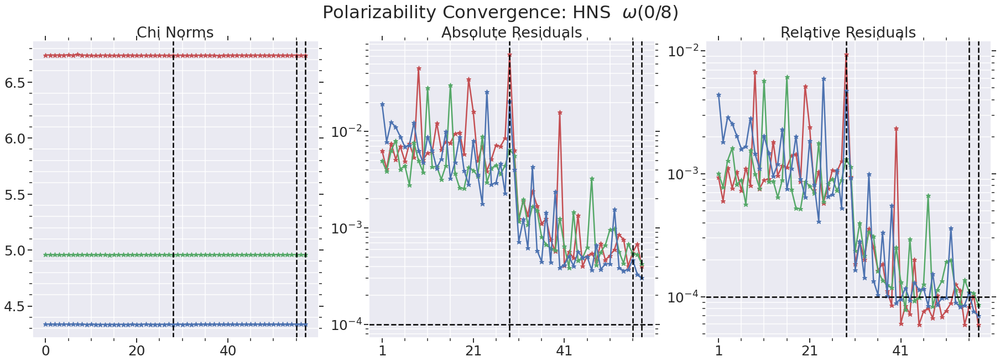

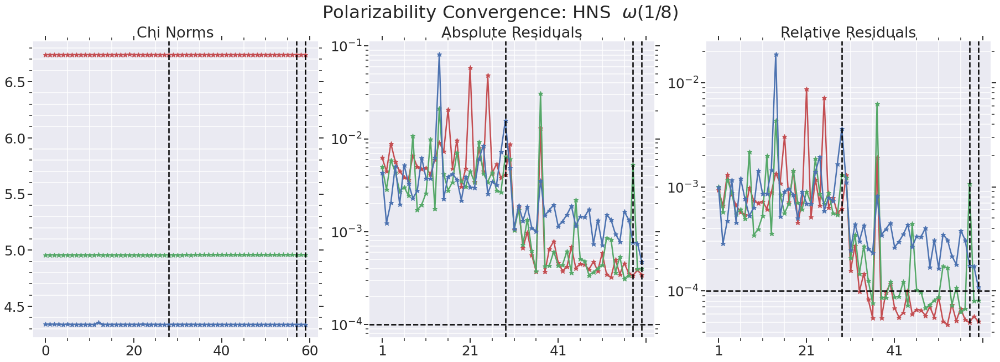

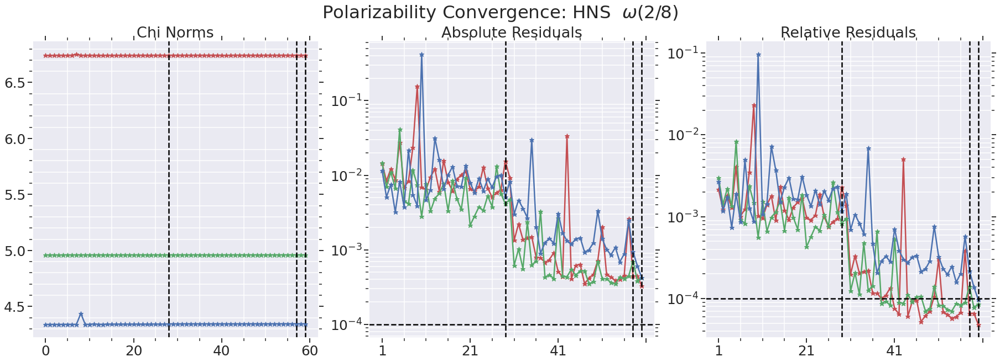

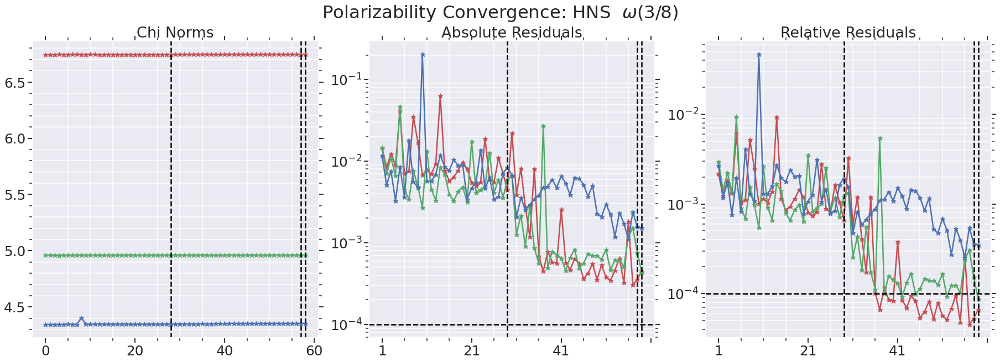

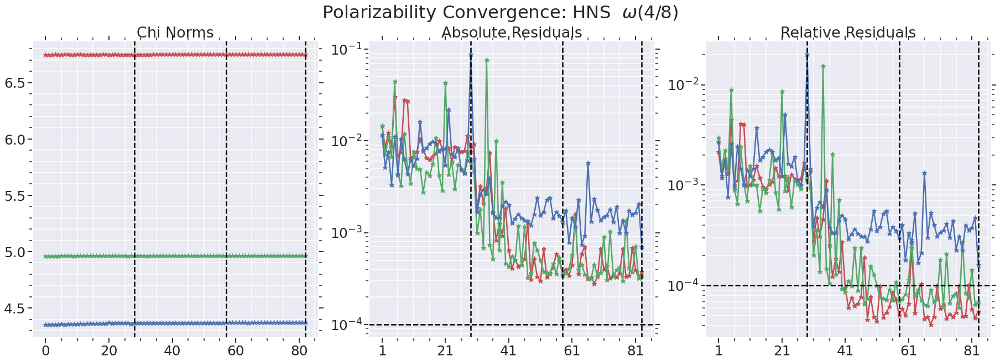

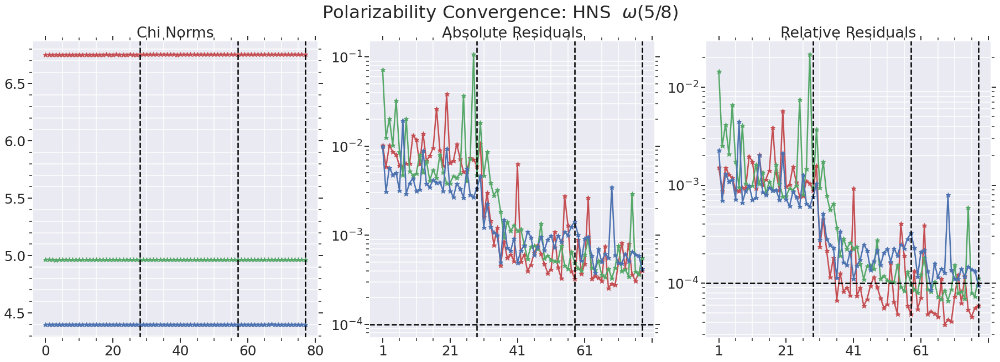

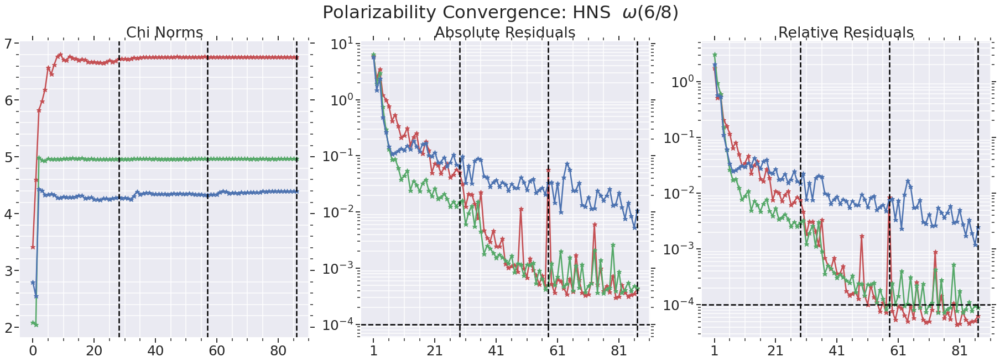

In [9]:
display(part_converged)
mol=part_converged[0]
freq_norm_and_residual(mol,'hf','dipole',True)

In [21]:
blist=basis_list[0:3]
dlist=d_basis_list[0:3]
blist5=basis_list[0:4]
dlist5=d_basis_list[0:4]
print(blist5)
print(dlist5)
mol_list=converged[:]

['aug-cc-pVDZ', 'aug-cc-pVTZ', 'aug-cc-pVQZ', 'aug-cc-pV5Z']
['d-aug-cc-pVDZ', 'd-aug-cc-pVTZ', 'd-aug-cc-pVQZ', 'd-aug-cc-pV5Z']


In [22]:
#tseries,mol_data=get_wall_time_series(converged,'hf','dipole')   
# get basis-set data for each molecule into a dictionary
#mol_data



In [23]:
print("num converged: ",len(converged))
print("part converged: ",len(part_converged))
print("type_error",len(type_error))
print("type_error",type_error)

print("molecules not finshed:\n----------------------------\n",part_converged+type_error,'\n-------------------------------------')
running=['HNS','PH3O','SF2','NaCN','OCl2','HOOH','Cl2','P2H4','C6H6','SCl2']

restart=[f for f in part_converged+type_error  if f not in running]
print("molecules needing restart:\n----------------------------\n",restart,'\n-------------------------------------')
print("molecules needing restart:\n----------------------------\n",part_converged,'\n-------------------------------------')



num converged:  85
part converged:  5
type_error 0
type_error []
molecules not finshed:
----------------------------
 ['OCl2', 'HNS', 'C6H6', 'NH2Cl', 'SCl2'] 
-------------------------------------
molecules needing restart:
----------------------------
 ['NH2Cl'] 
-------------------------------------
molecules needing restart:
----------------------------
 ['OCl2', 'HNS', 'C6H6', 'NH2Cl', 'SCl2'] 
-------------------------------------


In [24]:
def create_polar_diff_plot(mol, basis_list):
    fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(14,10),constrained_layout=True)
    title = 'Polarizability Convergence: ' + mol
    yl = r" $\Delta\alpha=\alpha($BASIS$) -\alpha($MRA$)$" 
    
    data, diff_data, energy_diff, polar_diff = create_data(mol, basis_list)
    num_freq = len(list(polar_diff.keys()))
    
    sns.set_theme(style="darkgrid")
    sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 2.5})
    polar_diff.iloc[:, :].plot(marker="v", linestyle="solid", markersize=12, linewidth=4, colormap='magma',ax=ax)
    legend = []
    for i in range(num_freq):
        legend.append(r'$\omega_{}$'.format(i))

    plt.axhline(linewidth=2, ls="--", color="k")
    plt.legend(legend)
    plt.xticks(rotation=20)
    plt.title(title)
    plt.ylabel(yl)
    btitle = basis_list[0].replace('D', 'X')
    save = mol + "-" + btitle
    if not os.path.exists("figures"):
        os.mkdir("figures")
    if not os.path.exists("tables"):
        os.mkdir("tables")
    save = "figures/" + save + ".svg"
    fig.savefig(save)

    latex_save = mol + "-" + btitle
    latex_save = "tables/" + latex_save + ".tex"
    data = data.round(decimals=4)
    data.style.to_latex(latex_save)

    return 

In [25]:
def polar_plot(mol,basis_list,ax):
    
    data, diff_data, energy_diff, polar_diff = create_data(mol, basis_list)
    num_freq = len(list(polar_diff.keys()))
    sns.set_theme(style="darkgrid")
    sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 2.5})
    
    btitle = basis_list[0].replace('D', 'X')
    
    polar_diff.iloc[:, :].plot(marker="v", linestyle="solid", markersize=12, linewidth=4,
                               colormap='magma',ax=ax,title=btitle)
    
    legend = []
    for i in range(num_freq):
        legend.append(r'$\omega_{}$'.format(i))
        

    ax.axhline(linewidth=2, ls="--", color="k")
    ax.legend(legend)
    #ax.set_xticks(rotation=20)
    yl = r" $\Delta\alpha=[\alpha($BASIS$) -\alpha($MRA$)]$" 
    ax.set_ylabel(yl)
    ax.set_xlabel(ax.get_xlabel(),rotation=45)
    
    
    
def create_polar_diff_subplot(mol,blist,dlist):
    
    fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(25,9),constrained_layout=True)
    title = 'Polarizability Convergence: ' + mol
    fig.suptitle(title)
    
    polar_plot(mol,blist,ax[0])
    polar_plot(mol,dlist,ax[1])
    
    btitle = basis_list[0].replace('D', 'X')
    save = mol + "-" + btitle
    if not os.path.exists("acs_mols"):
        os.mkdir("acs_mols")
    save = "acs_mols/" + save + ".svg"
    fig.savefig(save)
    return fig

    
    


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CSO/dipole/freq_CSO-d-aug-cc-pV5Z.out'
Try and run molecule  CSO
mpirun -n 2 dalton freq.dal CSO-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
: Permission denied


list index out of range
Try and run molecule  LiH
mpirun -n 2 dalton freq.dal LiH-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/FCN/dipole/freq_FCN-d-aug-cc-pV5Z.out'
Try and run molecule  FCN
mpirun -n 2 dalton freq.dal FCN-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/P2H4/dipole/freq_P2H4-d-aug-cc-pV5Z.out'
Try and run molecule  P2H4
mpirun -n 2 dalton freq.dal P2H4-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  LiH_s
mpirun -n 2 dalton freq.dal LiH_s-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  Li2
mpirun -n 2 dalton freq.dal Li2-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  NaCl
mpirun -n 2 dalton freq.dal NaCl-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/BH3/dipole/freq_BH3-aug-cc-pV5Z.out'
Try and run molecule  BH3
mpirun -n 2 dalton freq.dal BH3-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HCONH2/dipole/freq_HCONH2-aug-cc-pV5Z.out'
Try and run molecule  HCONH2
mpirun -n 2 dalton freq.dal HCONH2-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
/tmp/ipykernel_10415/1603530057.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(25,9),constrained_layout=True)
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CH3SH/dipole/freq_CH3SH-aug-cc-pV5Z.out'
Try and run molecule  CH3SH
mpirun -n 2 dalton freq.dal CH3SH-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None
[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/BH2Cl/dipole/freq_BH2Cl-d-aug-cc-pV5Z.out'
Try and run molecule  BH2Cl
mpirun -n 2 dalton freq.dal BH2Cl-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  NaCN
mpirun -n 2 dalton freq.dal NaCN-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  Na2
mpirun -n 2 dalton freq.dal Na2-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CH3NH2/dipole/freq_CH3NH2-aug-cc-pV5Z.out'
Try and run molecule  CH3NH2
mpirun -n 2 dalton freq.dal CH3NH2-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/NH3O/dipole/freq_NH3O-aug-cc-pV5Z.out'
Try and run molecule  NH3O
mpirun -n 2 dalton freq.dal NH3O-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HOF/dipole/freq_HOF-aug-cc-pV5Z.out'
Try and run molecule  HOF
mpirun -n 2 dalton freq.dal HOF-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HF/dipole/freq_HF-aug-cc-pV5Z.out'
Try and run molecule  HF
mpirun -n 2 dalton freq.dal HF-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/NH3/dipole/freq_NH3-aug-cc-pV5Z.out'
Try and run molecule  NH3
mpirun -n 2 dalton freq.dal NH3-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/Mg2/dipole/freq_Mg2-aug-cc-pV5Z.out'
Try and run molecule  Mg2
mpirun -n 2 dalton freq.dal Mg2-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/N2H4/dipole/freq_N2H4-d-aug-cc-pV5Z.out'
Try and run molecule  N2H4
mpirun -n 2 dalton freq.dal N2H4-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/SF2/dipole/freq_SF2-aug-cc-pV5Z.out'
Try and run molecule  SF2
mpirun -n 2 dalton freq.dal SF2-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HOCl/dipole/freq_HOCl-aug-cc-pV5Z.out'
Try and run molecule  HOCl
mpirun -n 2 dalton freq.dal HOCl-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HCCF/dipole/freq_HCCF-aug-cc-pV5Z.out'
Try and run molecule  HCCF
mpirun -n 2 dalton freq.dal HCCF-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  Mg
mpirun -n 2 dalton freq.dal Mg-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


'calculationTime'
Try and run molecule  CH3BH2
mpirun -n 2 dalton freq.dal CH3BH2-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/BF/dipole/freq_BF-aug-cc-pV5Z.out'
Try and run molecule  BF
mpirun -n 2 dalton freq.dal BF-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  LiCl
mpirun -n 2 dalton freq.dal LiCl-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/PH3O/dipole/freq_PH3O-aug-cc-pV5Z.out'
Try and run molecule  PH3O
mpirun -n 2 dalton freq.dal PH3O-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HBO/dipole/freq_HBO-aug-cc-pV5Z.out'
Try and run molecule  HBO
mpirun -n 2 dalton freq.dal HBO-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  LiCN
mpirun -n 2 dalton freq.dal LiCN-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  LiBH4
mpirun -n 2 dalton freq.dal LiBH4-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  BeH2
mpirun -n 2 dalton freq.dal BeH2-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/BH2F/dipole/freq_BH2F-aug-cc-pV5Z.out'
Try and run molecule  BH2F
mpirun -n 2 dalton freq.dal BH2F-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CH2NH/dipole/freq_CH2NH-d-aug-cc-pV5Z.out'
Try and run molecule  CH2NH
mpirun -n 2 dalton freq.dal CH2NH-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CH3F/dipole/freq_CH3F-d-aug-cc-pV5Z.out'
Try and run molecule  CH3F
mpirun -n 2 dalton freq.dal CH3F-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/ClCN/dipole/freq_ClCN-d-aug-cc-pV5Z.out'
Try and run molecule  ClCN
mpirun -n 2 dalton freq.dal ClCN-d-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


list index out of range
Try and run molecule  NaLi
mpirun -n 2 dalton freq.dal NaLi-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/Be/dipole/freq_Be-aug-cc-pV5Z.out'
Try and run molecule  Be
mpirun -n 2 dalton freq.dal Be-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/NH2OH/dipole/freq_NH2OH-aug-cc-pV5Z.out'
Try and run molecule  NH2OH
mpirun -n 2 dalton freq.dal NH2OH-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HCCCl/dipole/freq_HCCCl-aug-cc-pV5Z.out'
Try and run molecule  HCCCl
mpirun -n 2 dalton freq.dal HCCCl-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/NaH/dipole/freq_NaH-aug-cc-pV5Z.out'
Try and run molecule  NaH
mpirun -n 2 dalton freq.dal NaH-aug-cc-pV5Z.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


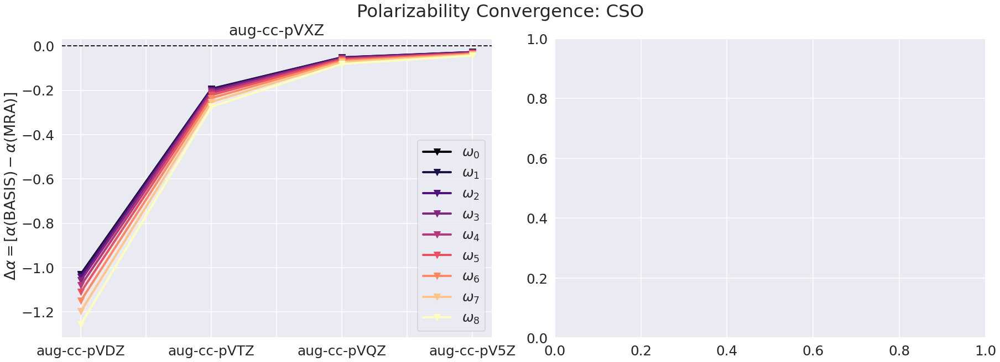

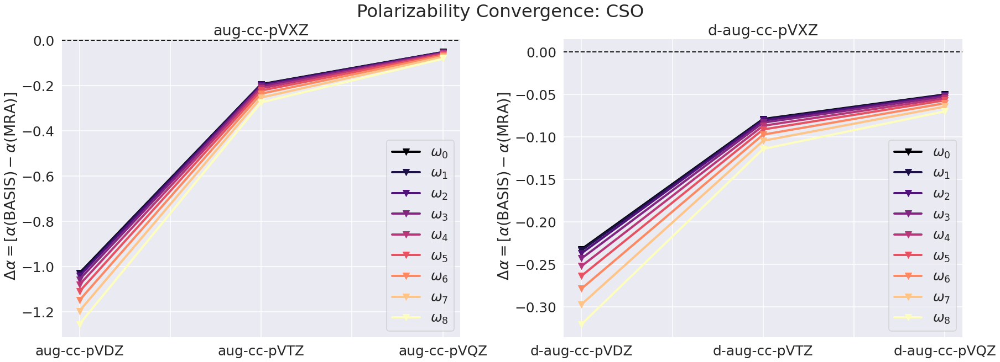

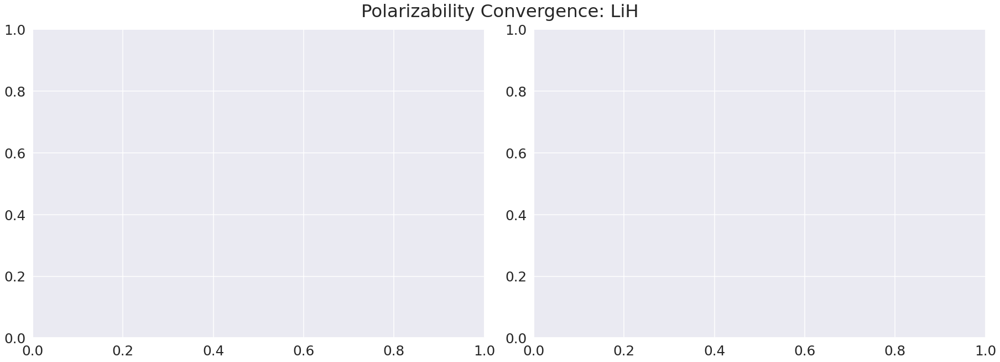

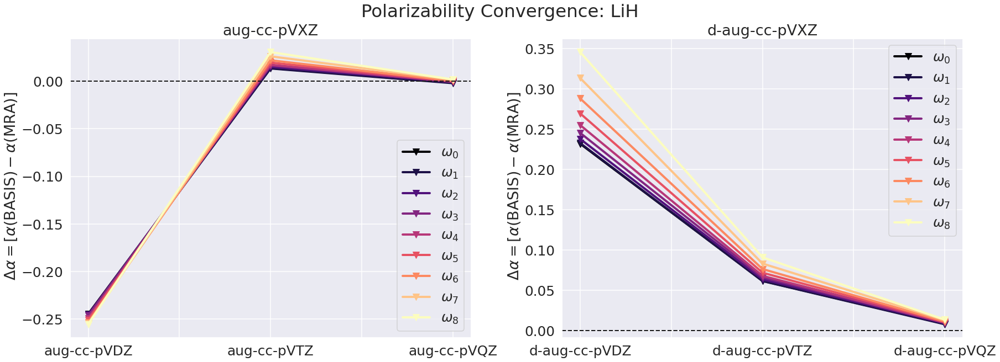

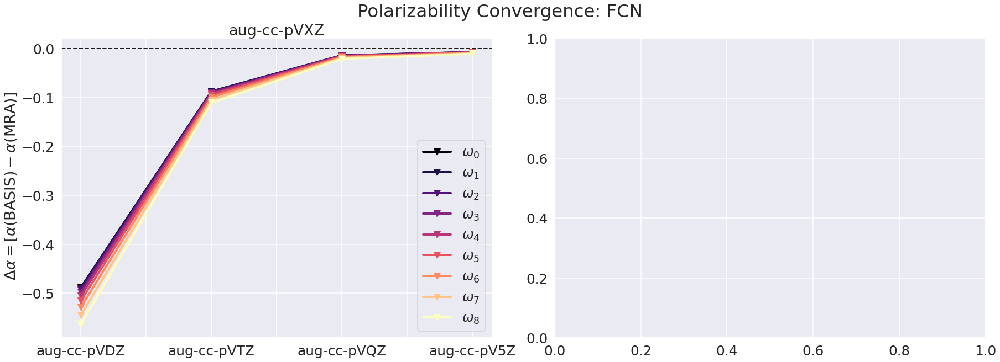

...

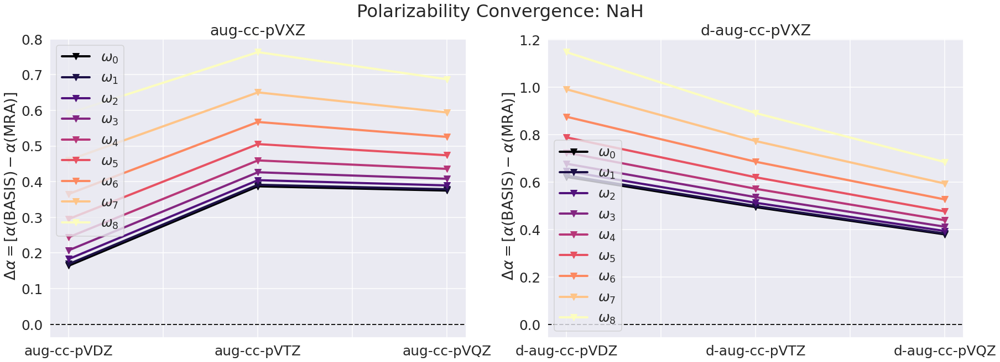

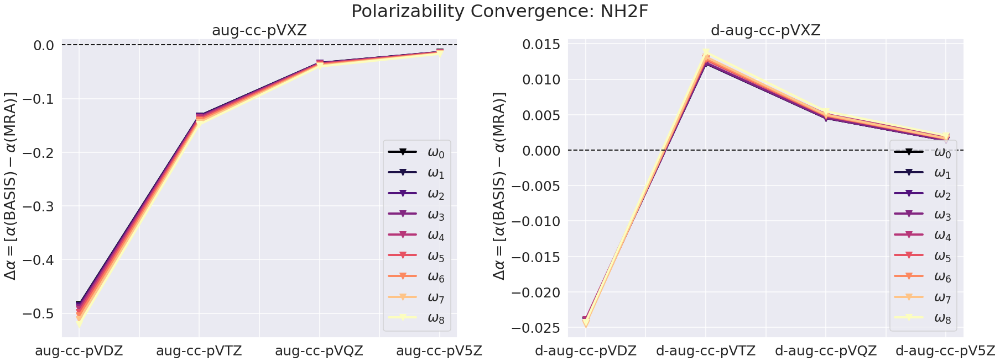

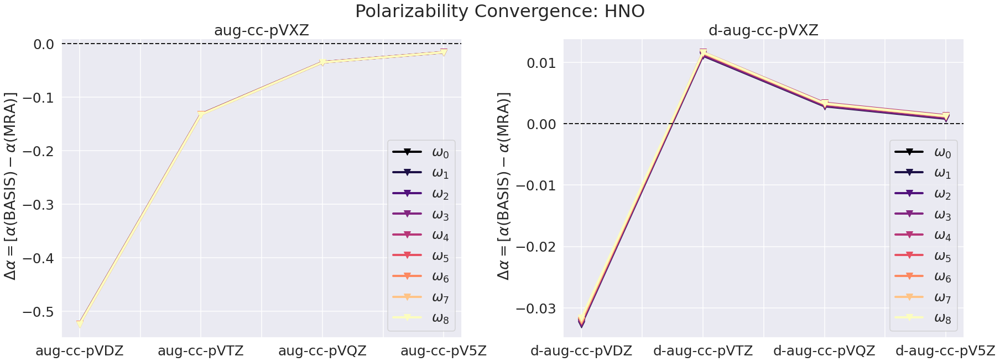

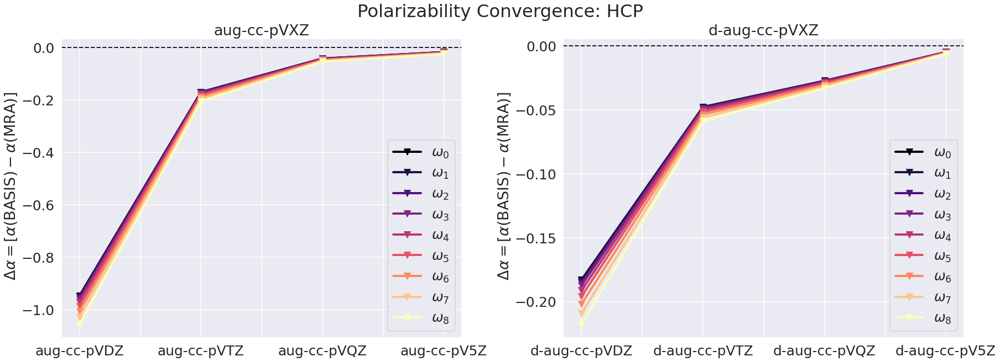

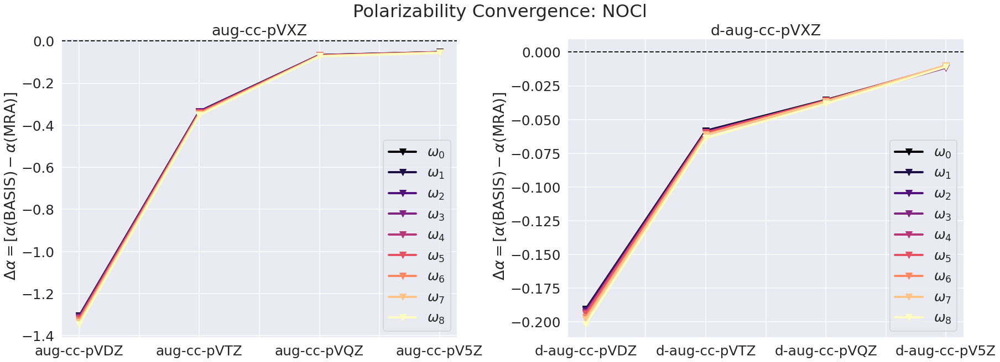

In [31]:
dz5_mol=[]
for mol in converged:
    try:
        f=create_polar_diff_subplot(mol,blist5,dlist5)
        dz5_mol.append(mol)
    except:
        f=create_polar_diff_subplot(mol,blist,dlist)
        
    #display_convergence_plots(mol,'hf','dipole',True)
    #frequency_norm_plots(mol,'hf','dipole',True)

[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/P2H4/dipole/freq_P2H4-d-aug-cc-pCVQZ.out'
Try and run molecule  P2H4
mpirun -n 2 dalton freq.dal P2H4-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HCONH2/dipole/freq_HCONH2-d-aug-cc-pCVQZ.out'
Try and run molecule  HCONH2
mpirun -n 2 dalton freq.dal HCONH2-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None
[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CH3SH/dipole/freq_CH3SH-aug-cc-pCVQZ.out'
Try and run molecule  CH3SH
mpirun -n 2 dalton freq.dal CH3SH-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/NaCN/dipole/freq_NaCN-d-aug-cc-pCVQZ.out'
Try and run molecule  NaCN
mpirun -n 2 dalton freq.dal NaCN-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
/tmp/ipykernel_10415/1603530057.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(25,9),constrained_layout=True)


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CH3NH2/dipole/freq_CH3NH2-aug-cc-pCVQZ.out'
Try and run molecule  CH3NH2
mpirun -n 2 dalton freq.dal CH3NH2-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/NH3O/dipole/freq_NH3O-d-aug-cc-pCVQZ.out'
Try and run molecule  NH3O
mpirun -n 2 dalton freq.dal NH3O-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HCOOH/dipole/freq_HCOOH-d-aug-cc-pCVQZ.out'
Try and run molecule  HCOOH
mpirun -n 2 dalton freq.dal HCOOH-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/N2H4/dipole/freq_N2H4-d-aug-cc-pCVQZ.out'
Try and run molecule  N2H4
mpirun -n 2 dalton freq.dal N2H4-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None
list index out of range
Try and run molecule  Ne
mpirun -n 2 dalton freq.dal Ne-aug-cc-pCVDZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/SiH3Cl/dipole/freq_SiH3Cl-d-aug-cc-pCVQZ.out'
Try and run molecule  SiH3Cl
mpirun -n 2 dalton freq.dal SiH3Cl-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HOOH/dipole/freq_HOOH-d-aug-cc-pCVQZ.out'
Try and run molecule  HOOH
mpirun -n 2 dalton freq.dal HOOH-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/CH3BH2/dipole/freq_CH3BH2-d-aug-cc-pCVQZ.out'
Try and run molecule  CH3BH2
mpirun -n 2 dalton freq.dal CH3BH2-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/LiBH4/dipole/freq_LiBH4-d-aug-cc-pCVQZ.out'
Try and run molecule  LiBH4
mpirun -n 2 dalton freq.dal LiBH4-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/BH2F/dipole/freq_BH2F-d-aug-cc-pCVQZ.out'
Try and run molecule  BH2F
mpirun -n 2 dalton freq.dal BH2F-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


[Errno 2] No such file or directory: '/home/adrianhurtado/testing/post_watoc/august/../dalton/hf/HCCCl/dipole/freq_HCCCl-d-aug-cc-pCVQZ.out'
Try and run molecule  HCCCl
mpirun -n 2 dalton freq.dal HCCCl-d-aug-cc-pCVQZ.mol
b'ERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\nERROR: you have no permission to create /media/adrianhurtado/NewScratch/DALTON_scratch_adrianhurtado\n' None


mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied
mkdir: cannot create directory ‘/media/adrianhurtado/NewScratch’: Permission denied


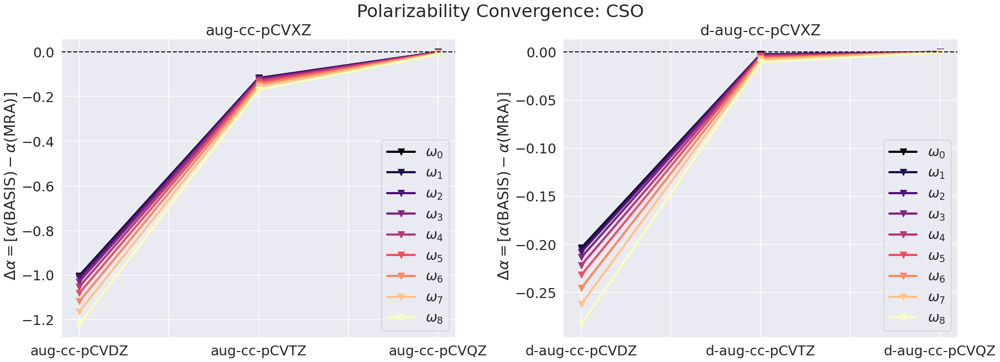

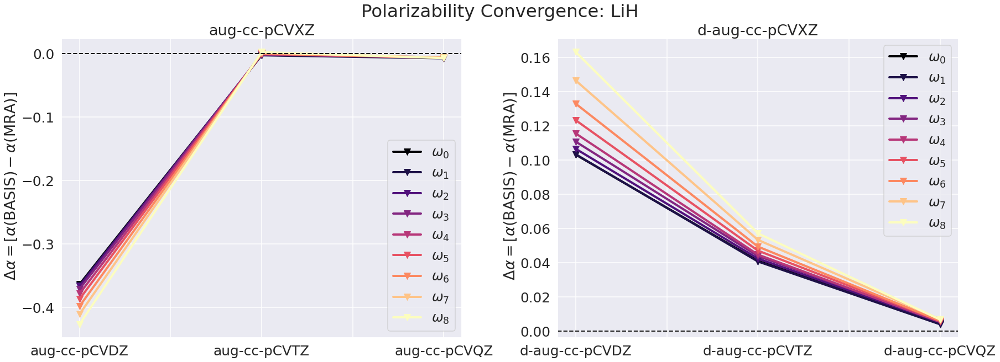

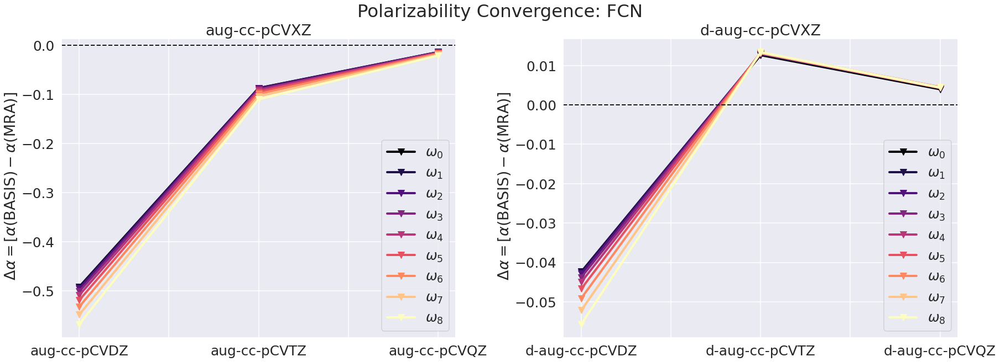

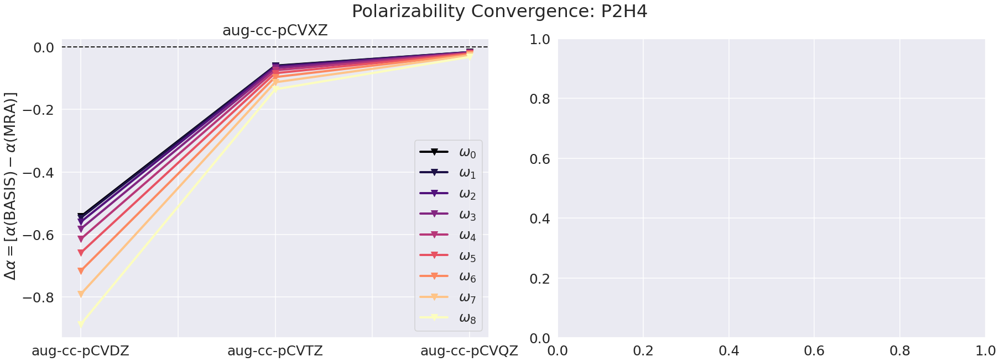

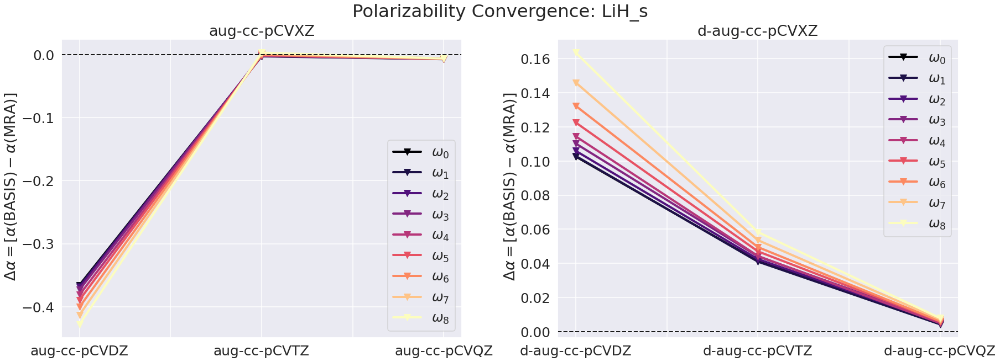

...

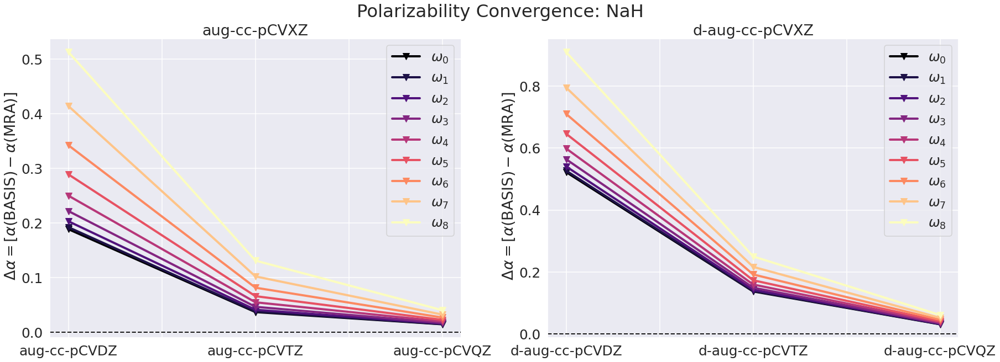

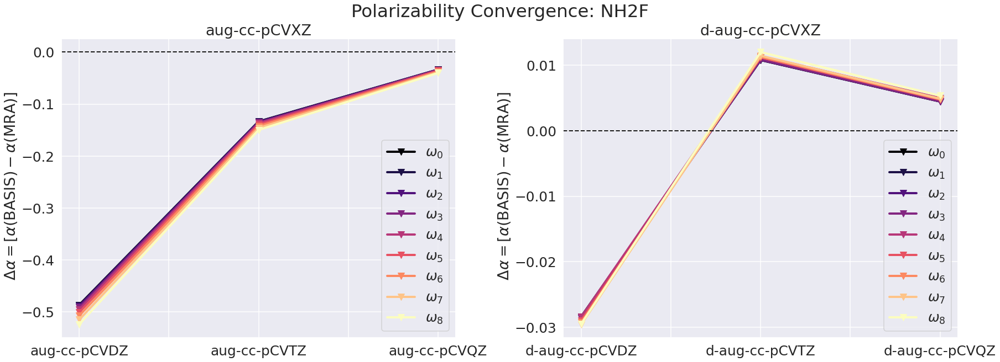

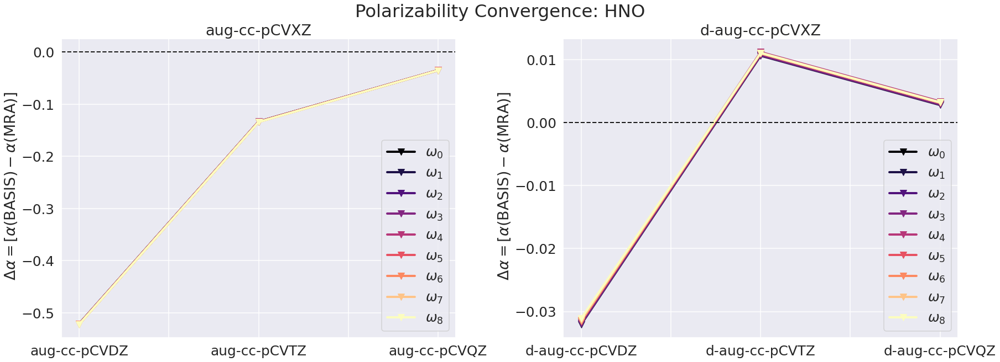

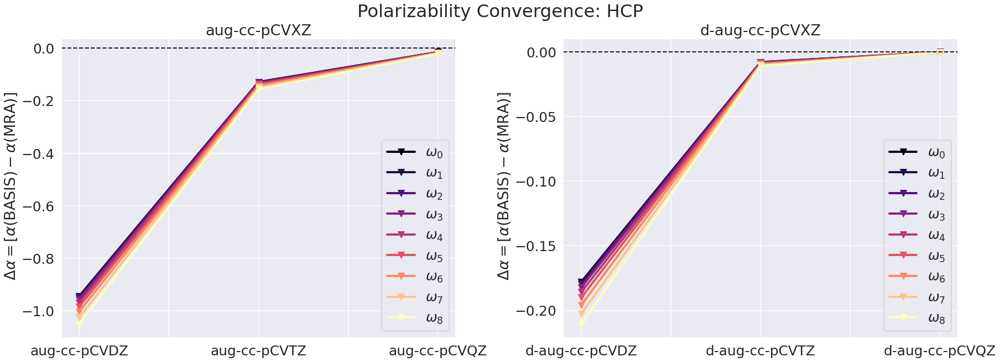

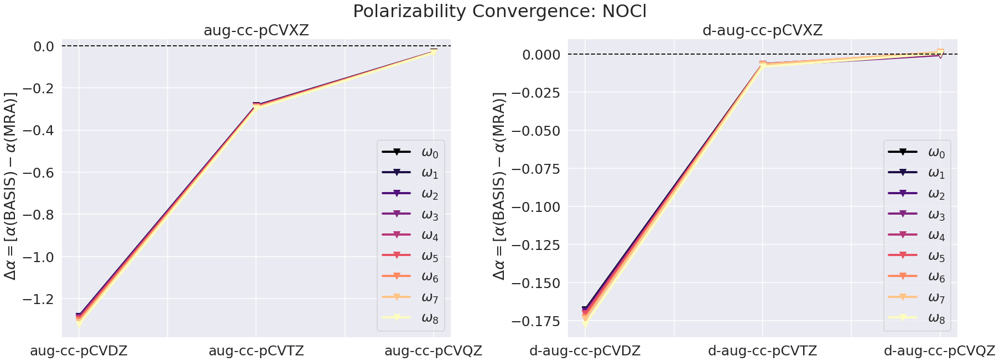

In [27]:
pc_mols=[]
for mol in converged:
    try:
        f=create_polar_diff_subplot(mol,pc_basis_list,dpc_basis_list)
        pc_mols.append(mol)
    except:
        pass

In [32]:
dz5_mol

['SH2',
 'C2H2',
 'P2',
 'HCN',
 'CH3OH',
 'HBS',
 'C2H4',
 'SO2',
 'HNC',
 'F2',
 'N2',
 'SiH4',
 'N2H2',
 'He',
 'OF2',
 'ClF',
 'HCOOH',
 'CH3Cl',
 'Ne',
 'HCHO',
 'SiH3Cl',
 'SiH3F',
 'HOOH',
 'H2',
 'HCl',
 'CH2BH',
 'SiO',
 'FNO',
 'H2O',
 'S2H2',
 'Ar',
 'BHF2',
 'O3',
 'Cl2',
 'CO',
 'CS',
 'CH4',
 'CO2',
 'PH3',
 'HCHS',
 'NH2F',
 'HNO',
 'HCP',
 'NOCl']

In [33]:
print(len(all_mols),' '.join(all_mols))
print(len(converged),' '.join(converged))
print(len(pc_mols),' '.join(pc_mols))
print(len(dz5_mol),' '.join(pc_mols))
print(' '.join(converged))
all_mols
pc_mols
dz5_mol

90 CSO LiH FCN P2H4 OCl2 LiH_s SH2 Li2 NaCl C2H2 BH3 HCONH2 CH3SH P2 BH2Cl NaCN HCN CH3OH HBS C2H4 SO2 HNC Na2 F2 N2 SiH4 N2H2 CH3NH2 NH3O HOF He HF OF2 ClF HCOOH NH3 CH3Cl Mg2 N2H4 Ne HCHO SiH3Cl SF2 SiH3F HOCl HOOH H2 HCl HCCF Mg CH2BH CH3BH2 BF SiO FNO H2O S2H2 LiCl PH3O Ar BHF2 HNS O3 HBO Cl2 C6H6 NH2Cl LiCN CO CS LiBH4 CH4 BeH2 BH2F CH2NH CH3F CO2 PH3 ClCN HCHS NaLi SCl2 Be NH2OH HCCCl NaH NH2F HNO HCP NOCl
85 CSO LiH FCN P2H4 LiH_s SH2 Li2 NaCl C2H2 BH3 HCONH2 CH3SH P2 BH2Cl NaCN HCN CH3OH HBS C2H4 SO2 HNC Na2 F2 N2 SiH4 N2H2 CH3NH2 NH3O HOF He HF OF2 ClF HCOOH NH3 CH3Cl Mg2 N2H4 Ne HCHO SiH3Cl SF2 SiH3F HOCl HOOH H2 HCl HCCF Mg CH2BH CH3BH2 BF SiO FNO H2O S2H2 LiCl PH3O Ar BHF2 O3 HBO Cl2 LiCN CO CS LiBH4 CH4 BeH2 BH2F CH2NH CH3F CO2 PH3 ClCN HCHS NaLi Be NH2OH HCCCl NaH NH2F HNO HCP NOCl
70 CSO LiH FCN LiH_s SH2 Li2 NaCl C2H2 BH3 P2 BH2Cl HCN CH3OH HBS C2H4 SO2 HNC Na2 F2 N2 SiH4 N2H2 HOF He HF OF2 ClF NH3 CH3Cl Mg2 HCHO SF2 SiH3F HOCl H2 HCl HCCF Mg CH2BH BF SiO FNO H2O S2H2 L

['SH2',
 'C2H2',
 'P2',
 'HCN',
 'CH3OH',
 'HBS',
 'C2H4',
 'SO2',
 'HNC',
 'F2',
 'N2',
 'SiH4',
 'N2H2',
 'He',
 'OF2',
 'ClF',
 'HCOOH',
 'CH3Cl',
 'Ne',
 'HCHO',
 'SiH3Cl',
 'SiH3F',
 'HOOH',
 'H2',
 'HCl',
 'CH2BH',
 'SiO',
 'FNO',
 'H2O',
 'S2H2',
 'Ar',
 'BHF2',
 'O3',
 'Cl2',
 'CO',
 'CS',
 'CH4',
 'CO2',
 'PH3',
 'HCHS',
 'NH2F',
 'HNO',
 'HCP',
 'NOCl']

In [34]:
data1=create_basis_set_df(blist+dlist,converged,9)
data2=create_basis_set_df(blist+dlist+pc_basis_list+dpc_basis_list,pc_mols,9)
data3=create_basis_set_df(blist5+dlist5,dz5_mol,9)

aug-cc-pVDZ
aug-cc-pVTZ
aug-cc-pVQZ
d-aug-cc-pVDZ
d-aug-cc-pVTZ
d-aug-cc-pVQZ
aug-cc-pVDZ
aug-cc-pVTZ
aug-cc-pVQZ
d-aug-cc-pVDZ
d-aug-cc-pVTZ
d-aug-cc-pVQZ
aug-cc-pCVDZ
aug-cc-pCVTZ
aug-cc-pCVQZ
d-aug-cc-pCVDZ
d-aug-cc-pCVTZ
d-aug-cc-pCVQZ
aug-cc-pVDZ
aug-cc-pVTZ
aug-cc-pVQZ
aug-cc-pV5Z
d-aug-cc-pVDZ
d-aug-cc-pVTZ
d-aug-cc-pVQZ
d-aug-cc-pV5Z


In [35]:
data_keys=list(data1.keys())

def find_outlier(data,dtype,basis,cutoff):
    aqz=data.loc[data['basis']==basis]
    

    outlier_df=aqz.loc[aqz.loc[:,dtype].abs()>cutoff]
    outlier_list=list(outlier_df.loc[:,'molecule'])
    
    out_idx=data.molecule.isin(outlier_list)
    
    keep=data.loc[~out_idx,:]  
    remove=data.loc[out_idx,:]  
    
    return keep,remove

# Finding outliers

We choose the largest basis-set of the dataset and remove molecules with absolute error greater than threshold. 

In dataset including **aug**-cc-pVXZ and **d-aug**-cc-pVXZ results the molecules with an absolute error > .15 in the spherically averaged static polarizability where, 

- ['NaCl', 'Na2', 'Mg2', 'Mg', 'NaLi', 'NaH']

All first and second elements.



In [36]:
print(data_keys)
dtype=data_keys[2]
# given a dataset remove outlier molecules with absolute error greater than d-aug-cc-pVQZ compared to MRA
data1_keep,data_1removed=find_outlier(data1,dtype,'d-aug-cc-pVQZ',.15)
outlier_molecules=list(data_1removed.molecule.unique())
print(outlier_molecules)
#outlier_df.index
#aqz.iloc[:,0]

    

['molecule', 'Total HF Energy', '$\\alpha(\\omega_0)$', '$\\alpha(\\omega_1)$', '$\\alpha(\\omega_2)$', '$\\alpha(\\omega_3)$', '$\\alpha(\\omega_4)$', '$\\alpha(\\omega_5)$', '$\\alpha(\\omega_6)$', '$\\alpha(\\omega_7)$', '$\\alpha(\\omega_8)$', 'basis']
['NaCl', 'NaCN', 'Na2', 'Mg2', 'Mg', 'NaLi', 'NaH']


In [37]:
    print(len(converged))
print(len(converged)-7)
print(len(pc_mols))
print(len(dz5_mol))


85
78
70
44


In [38]:
def seperate_augmentation(data,blist,dlist):
    
    d1=data.loc[data.basis.isin(blist)]# not augmented
    num_data=len(list(d1.index))
    d2=data.loc[data.basis.isin(dlist)]# augmented
    
    daug=[True for i in range(num_data)]
    aug_true=pd.Series(daug)
    aug_true.index=d2.index
    aug_true.name='d-aug'
    
    aug_false=~aug_true
    aug_false.index=d1.index
    aug_false.name='d-aug'
    
    base_vals=d1.loc[:,'basis'].values
    d2.loc[:,'basis']=base_vals
    
    d2=pd.concat([d2,aug_true],axis=1)
    d1=pd.concat([d1,aug_false],axis=1)
    
    return pd.concat([d1,d2])

def augmentation_violin_plot(data,data_id,ax):
    
    sns.set_theme(style="darkgrid")
    sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 2.5})
    
    p1=sns.violinplot(x=data['basis'],y=data[data_id],hue=data['d-aug']
                      ,ax=ax,split=True,scale="count",inner='quartile',scale_hue=False)
    p11=sns.swarmplot(x=data['basis'],y=data[data_id],hue=data['d-aug'],ax=ax,size=5.0,dodge=True,color='.2')
    
    ax.axhline(y=0,linewidth=2, ls="--", color="r")
    
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[:2],['aug-cc-pVXZ','d-aug-cc-pVXZ'])
    ax.set_title(data_id ,fontsize=30)
    
    ax.set_xlabel('Basis',fontsize=28)
    ax.set_ylabel(r'$\Delta$'+data_id+' : [(basis) - (MRA)]',fontsize=28)
    nblist=len(list(data['basis'].unique()))
    xticks=[i for i in range(nblist)]
    labels=['D','T','Q','5','6']
    ax.set_xticks(xticks,labels=labels[0:nblist],fontsize=24)

def augmentation_series_violin_plots(data,blist,dlist):
    compare_data=seperate_augmentation(data,blist,dlist)
    fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(18,12),constrained_layout=True)
    augmentation_violin_plot(compare_data,data_keys[1],ax[0])
    augmentation_violin_plot(compare_data,data_keys[2],ax[1])
    #augmentation_violin_plot(compare_data,data_keys[10],ax[2])
    
    b1=blist[-1].replace('Q','X')
    b2=dlist[-1].replace('Q','X')
    fig.suptitle('Comparing '+b1+ ' and '+ b2)
    return fig

def seperate_polarization(data,blist,dlist):
    ## seperate based on polarized vs not.... both will be d-aug-cc-p()VXZ simply C or not
    
    d1=data.loc[data.basis.isin(blist)]# not augmented
    num_data=len(list(d1.index))
    d2=data.loc[data.basis.isin(dlist)]# augmented
    
    daug=[True for i in range(num_data)]
    aug_true=pd.Series(daug)
    aug_true.index=d2.index
    aug_true.name='polarized'
    
    aug_false=~aug_true
    aug_false.index=d1.index
    aug_false.name='polarized'
    
    base_vals=d1.loc[:,'basis'].values
    d2.loc[:,'basis']=base_vals
    
    d2=pd.concat([d2,aug_true],axis=1)
    d1=pd.concat([d1,aug_false],axis=1)
    
    return pd.concat([d1,d2])

def polarization_violin_plot(data,data_id,ax):
    
    blist=list(data.basis.unique())
    
    sns.set_theme(style="darkgrid")
    sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 2.5})
    
    p1=sns.violinplot(x=data['basis'],y=data[data_id],hue=data['polarized']
                      ,ax=ax,split=True,scale="count",inner='quartile',scale_hue=False)
    p11=sns.swarmplot(x=data['basis'],y=data[data_id],hue=data['polarized'],ax=ax,size=5.0,dodge=True,color='.2')
    
    handles, labels = ax.get_legend_handles_labels()
    if blist[0]=='aug-cc-pVDZ':
        ax.legend(handles[:2],['aug-cc-pVXZ','aug-cc-pCVXZ']) 
    elif blist[0]=='d-aug-cc-pVDZ':
        ax.legend(handles[:2],['d-aug-cc-pVXZ','d-aug-cc-pCVXZ']) 
            
    ax.axhline(y=0,linewidth=2, ls="--", color="r")
    ax.set_title(data_id ,fontsize=30)
    
    ax.set_xlabel('Basis',fontsize=28)
    ax.set_ylabel(r'$\Delta$'+data_id+' : [(basis) - (MRA)]',fontsize=28)
    nblist=len(list(data['basis'].unique()))
    xticks=[i for i in range(nblist)]
    labels=['D','T','Q','5','6']
    ax.set_xticks(xticks,labels=labels[0:nblist],fontsize=24)

def polarization_series_violin_plots(data,blist,dlist):
    compare_data=seperate_polarization(data,blist,dlist)
    fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(18,12),constrained_layout=True)
    polarization_violin_plot(compare_data,data_keys[1],ax[0])
    polarization_violin_plot(compare_data,data_keys[2],ax[1])
    #polarization_violin_plot(compare_data,data_keys[10],ax[2])
    
    b1=blist[-1].replace('Q','X')
    b2=dlist[-1].replace('Q','X')
    fig.suptitle('Comparing '+b1+ ' and '+ b2)
    return fig

def plot_bar(data,basis,data_id,ax):
    data=data.loc[data['basis']==basis].sort_values(data_id)
    sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 2.5})
    if data_id==data_keys[1]:
        diverging_colors=sns.color_palette('Blues',len(data))
    else:
        diverging_colors=sns.color_palette('RdBu',len(data))
    sns.barplot(x=data.molecule.values,y=data[data_id],palette=diverging_colors,ax=ax)
    ax.set_xticklabels(labels=data.molecule,rotation=90,fontsize=16)
    ax.set_ylabel(r'$\Delta$'+data_id+r'$=\alpha($'+basis +r'$) - \alpha(MRA)$')
    ax.set_title('Error: ' +data_id+' : '+basis)
# and clears it if it already exists.


def compare_bar_plots(data,b1,b2,data_id):
    
    fig, ax = plt.subplots(nrows=2,ncols=1,figsize=(15,15),constrained_layout=True)
    
    plot_bar(data,b1,data_id,ax[0])
    plot_bar(data,b2,data_id,ax[1])
    fig.suptitle('Comparison between '+b1 + ' and '+ b2)
    
    return fig

def single_bar_plots(data,b1,data_id,redline):
    
    fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(15,10),constrained_layout=True)
    ax.axhline(y=redline,linewidth=2, ls="--", color="r")
    ax.axhline(y=-redline,linewidth=2, ls="--", color="r")
    
    plot_bar(data,b1,data_id,ax)
    #fig.suptitle('Comparison between '+b1 + ' and '+ b2)
    
    return fig
    #ax.legend(['aug-cc-pVXZ','d-aug-cc-pVXZ'],fontsize=24)
    

def series_compare_violin_plot(data,data_id,ax,dtitle):
    
    
    sns.set_theme(style="darkgrid")
    sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 2.5})
    
    p1=sns.violinplot(x=data['basis'],y=data[data_id],hue=data['d-aug']
                      ,ax=ax,split=True,scale="count",inner='quartile',scale_hue=False)
    p11=sns.swarmplot(x=data['basis'],y=data[data_id],hue=data['d-aug'],ax=ax,size=5.0,dodge=True,color='.2')
    
    ax.axhline(y=0,linewidth=2, ls="--", color="r")
    
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[:2],['aug-cc-pVXZ','d-aug-cc-pVXZ'])
    ax.set_title(data_id+' : '+dtitle ,fontsize=30)
    
    ax.set_xlabel('Basis',fontsize=28)
    ax.set_ylabel(r'$\Delta$'+data_id+' : [(basis) - (MRA)]',fontsize=28)
    
    
    ax.set_xlabel('Basis',fontsize=28)
    ax.set_ylabel(r'$\Delta$'+data_id+' : [(basis) - (MRA)]',fontsize=28)
    nblist=len(list(data['basis'].unique()))
    xticks=[i for i in range(nblist)]
    labels=['D','T','Q','5','6']
    ax.set_xticks(xticks,labels=labels[0:nblist],fontsize=24)
    
def compare_series_violin_plots(data1,data2,data_id,blist,dlist,dtitle1,dtitle2):
    compare_data1=seperate_augmentation(data1,blist,dlist)
    compare_data2=seperate_augmentation(data2,blist,dlist)
    fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(20,11),constrained_layout=True)
    
    series_compare_violin_plot(compare_data1,data_id,ax[0],dtitle1)
    series_compare_violin_plot(compare_data2,data_id,ax[1],dtitle2)
    
    #fig.suptitle('Removing Outliers')
    return fig


/tmp/ipykernel_10415/426774053.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d2.loc[:,'basis']=base_vals
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 42.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 15.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 5.9% of the points cannot be placed; you may want to decrease the 

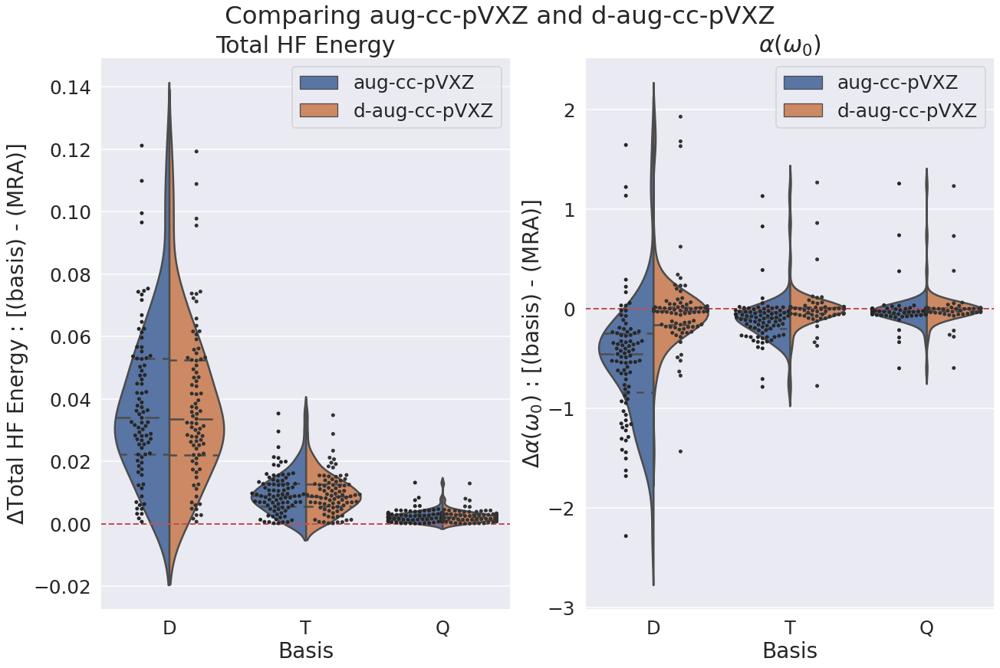

In [39]:
f1=augmentation_series_violin_plots(data1,blist,dlist)
f1.savefig('acs_plots_new/violin-aug_vs_daug.svg')


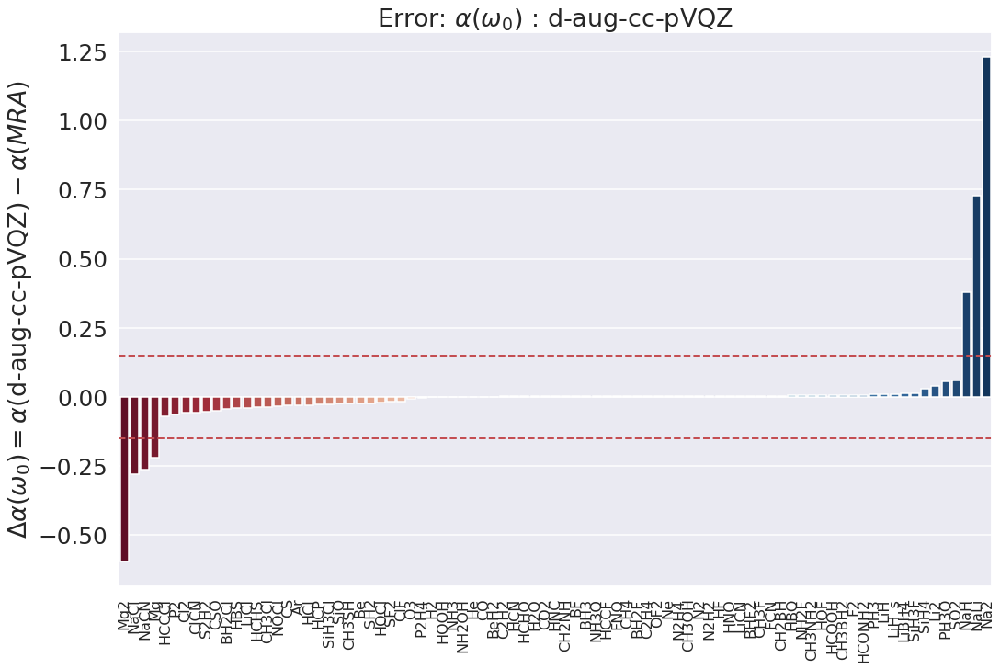

In [40]:
bar_aug=single_bar_plots(data1,'d-aug-cc-pVQZ',data_keys[2],.15)
bar_aug.savefig('acs_plots_new/bar_pvqz.svg')

/tmp/ipykernel_10415/426774053.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d2.loc[:,'basis']=base_vals
/tmp/ipykernel_10415/426774053.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d2.loc[:,'basis']=base_vals
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 14.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-

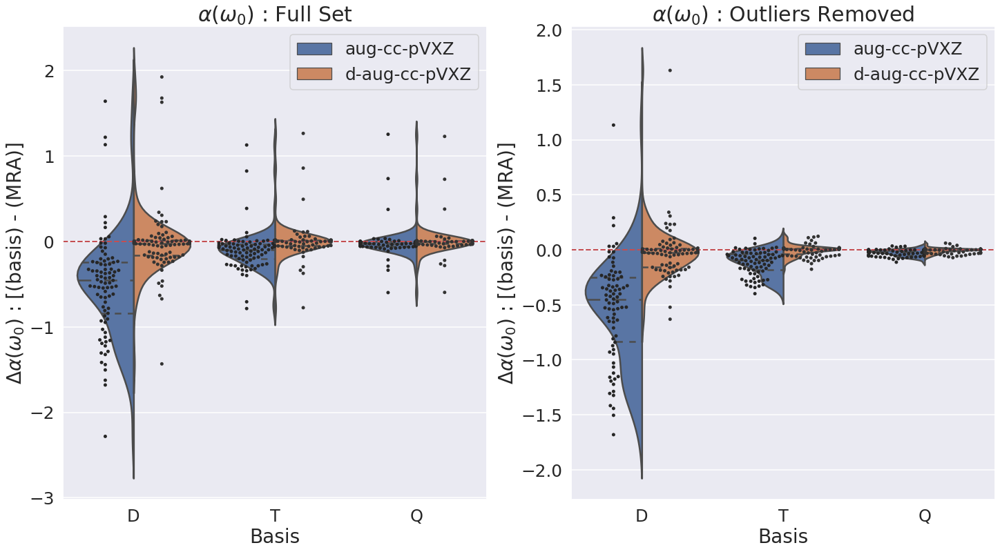

In [41]:
f1=compare_series_violin_plots(data1,data1_keep,data_keys[2],blist,dlist,'Full Set','Outliers Removed')
f1.savefig('acs_plots_new/violin_outliers_removed.svg')

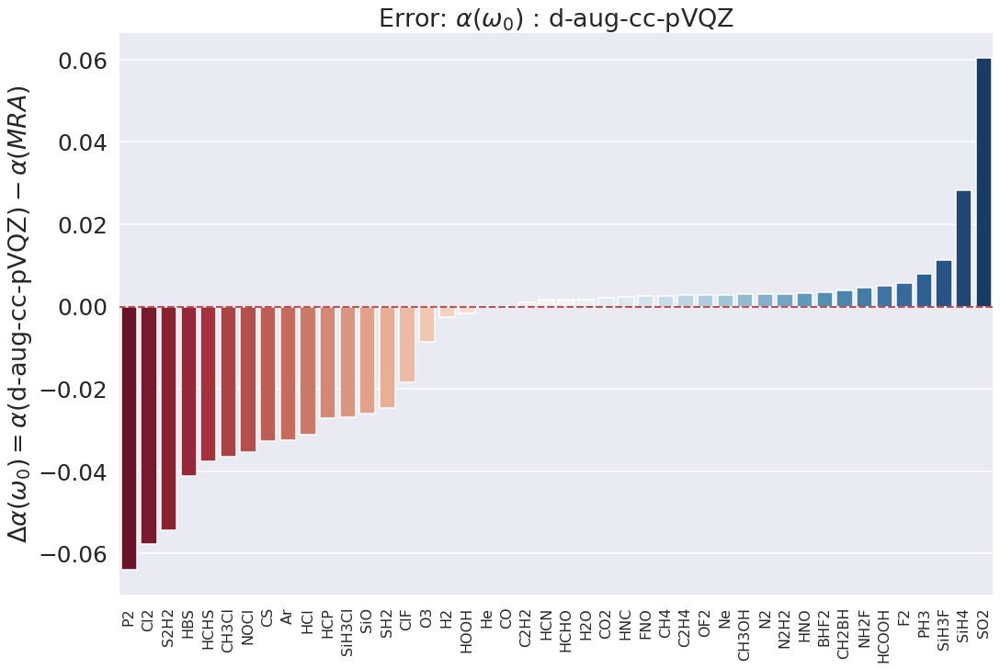

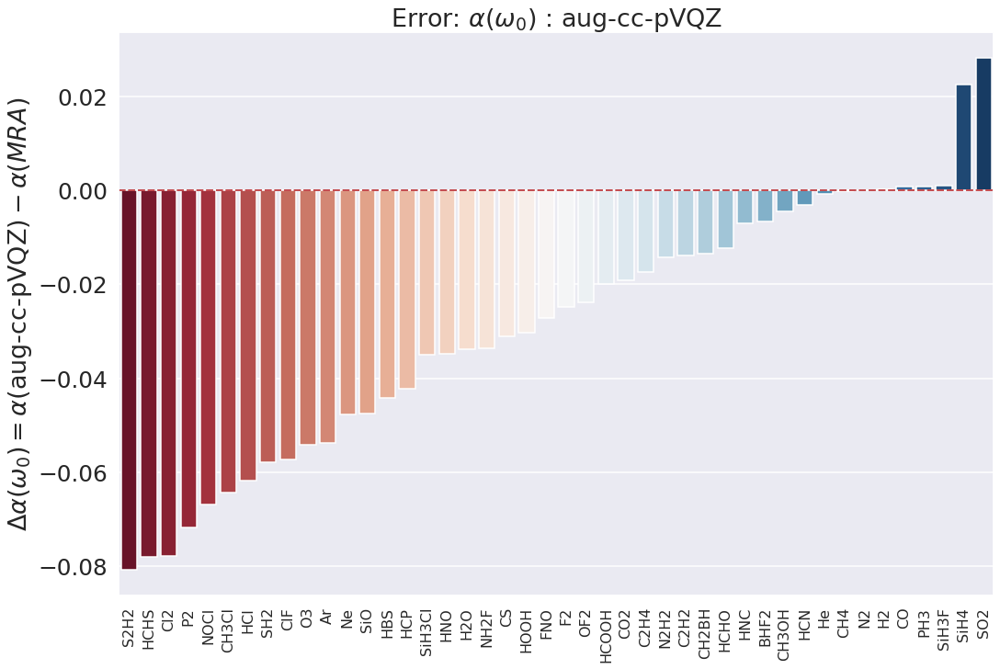

In [51]:

bar_aug5=single_bar_plots(data3,'d-aug-cc-pVQZ',data_keys[2],0)
bar_aug5.savefig('acs_plots_new/bar_dpv5z.svg')

bar_aug5=single_bar_plots(data3,'aug-cc-pVQZ',data_keys[2],0)
bar_aug5.savefig('acs_plots_new/bar_pv5z.svg')

/tmp/ipykernel_10415/1603530057.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(25,9),constrained_layout=True)


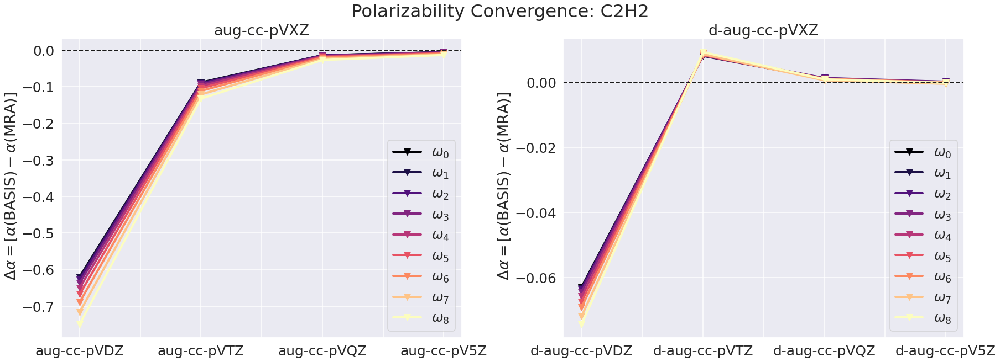

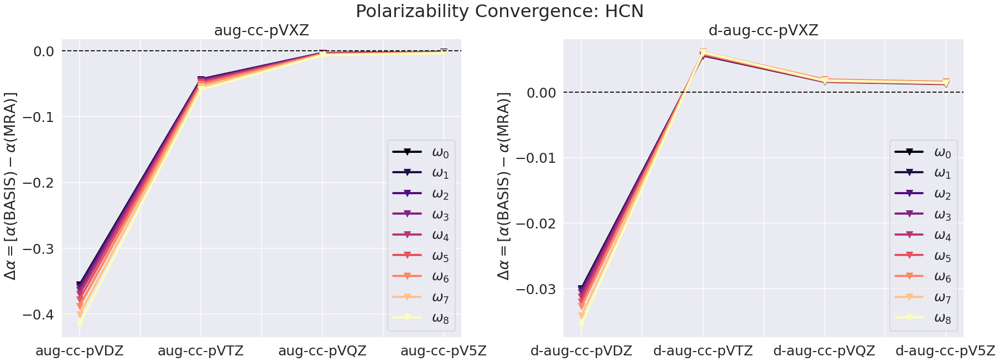

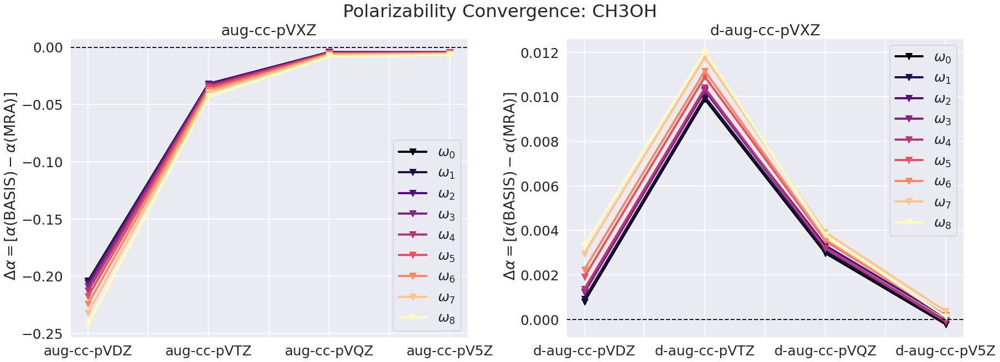

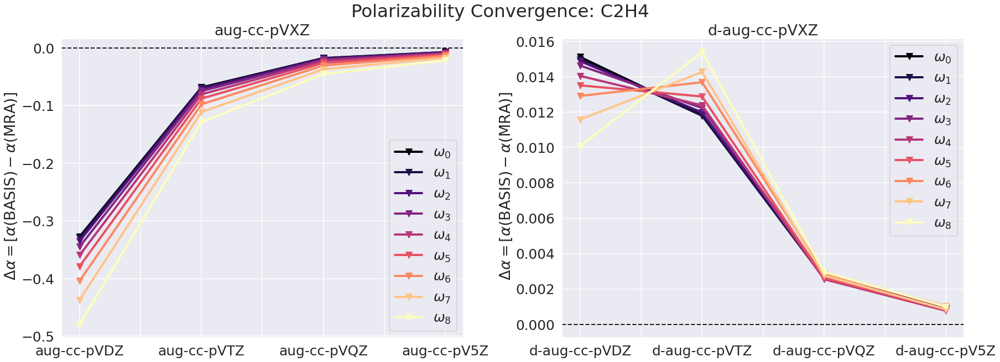

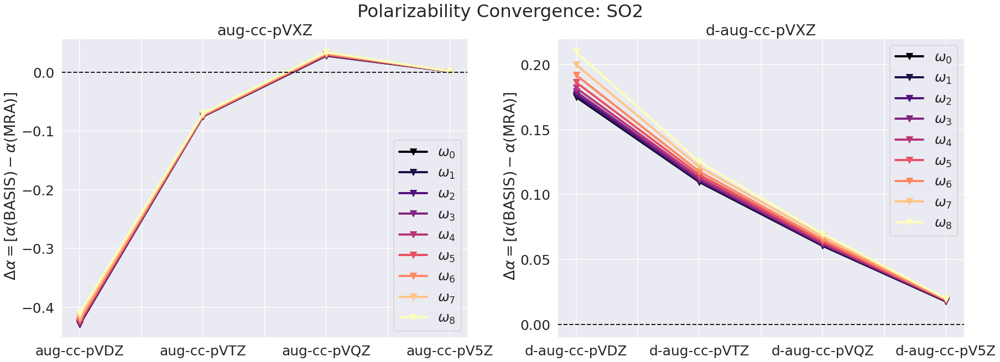

...

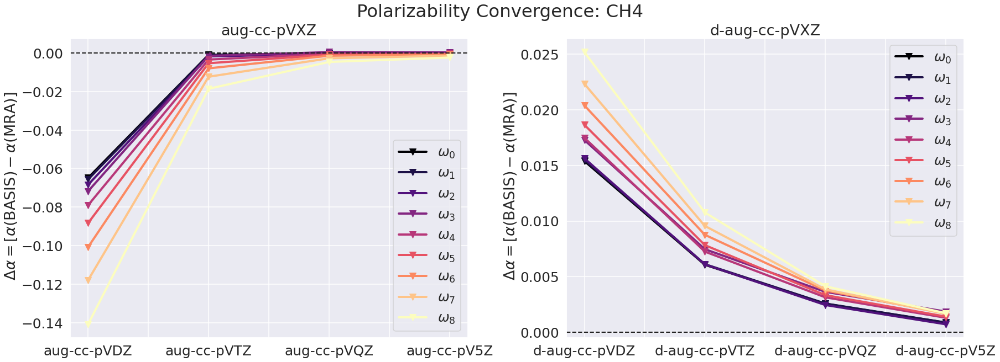

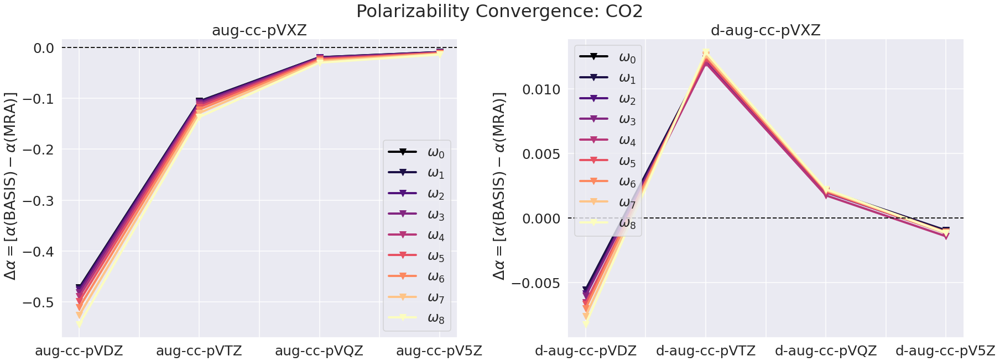

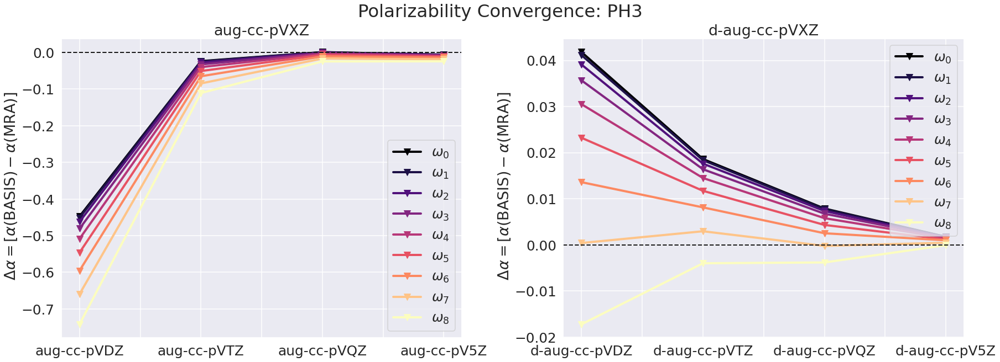

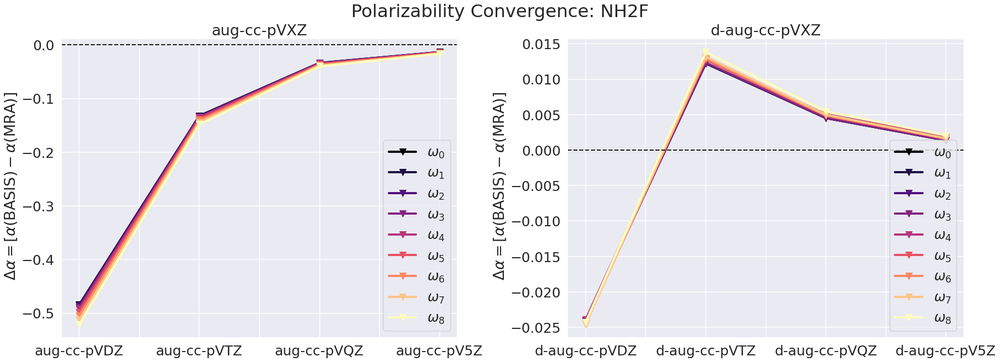

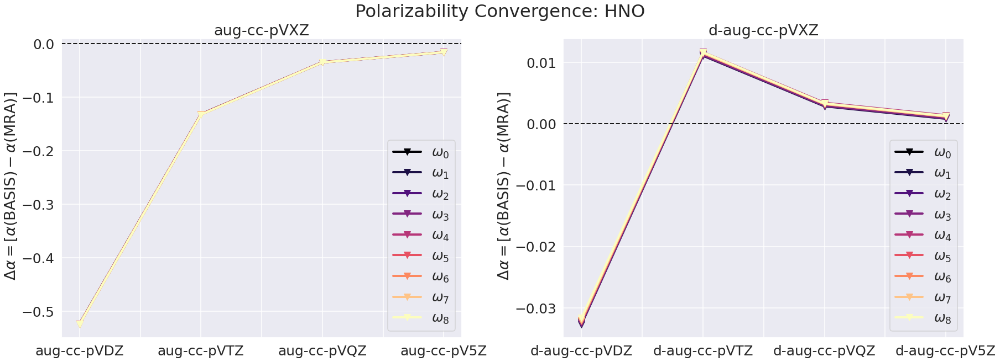

In [43]:
subset=data3.loc[data3['basis']=='d-aug-cc-pVQZ']
from_above=list(subset.loc[subset[data_keys[2]]>0].molecule.values)

for mol in from_above:
    f=create_polar_diff_subplot(mol,blist5,dlist5)
    f.savefig('acs_plots_new/'+mol+'.svg')

In [44]:
from_above

['C2H2',
 'HCN',
 'CH3OH',
 'C2H4',
 'SO2',
 'HNC',
 'F2',
 'N2',
 'SiH4',
 'N2H2',
 'He',
 'OF2',
 'HCOOH',
 'Ne',
 'HCHO',
 'SiH3F',
 'CH2BH',
 'FNO',
 'H2O',
 'BHF2',
 'CO',
 'CH4',
 'CO2',
 'PH3',
 'NH2F',
 'HNO']

In [45]:
data4=create_basis_set_df(blist5+dlist5,from_above,9)


aug-cc-pVDZ
aug-cc-pVTZ
aug-cc-pVQZ
aug-cc-pV5Z
d-aug-cc-pVDZ
d-aug-cc-pVTZ
d-aug-cc-pVQZ
d-aug-cc-pV5Z


/tmp/ipykernel_10415/426774053.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d2.loc[:,'basis']=base_vals
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 15.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 61.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 38.5% of the points cannot be placed; you may want to decrease the

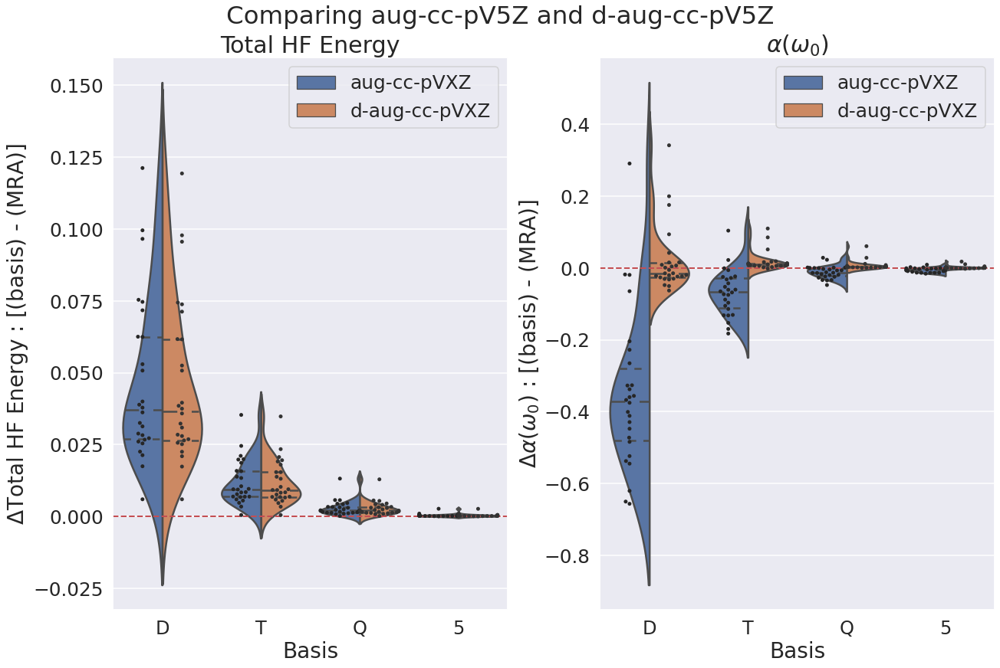

In [46]:
f1=augmentation_series_violin_plots(data4,blist5,dlist5)
f1.savefig('acs_plots_new/violin-from_above.svg')

/tmp/ipykernel_10415/426774053.py:75: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d2.loc[:,'basis']=base_vals
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 35.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 45.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 5.7% of the points cannot be placed; you may want to decrease the 

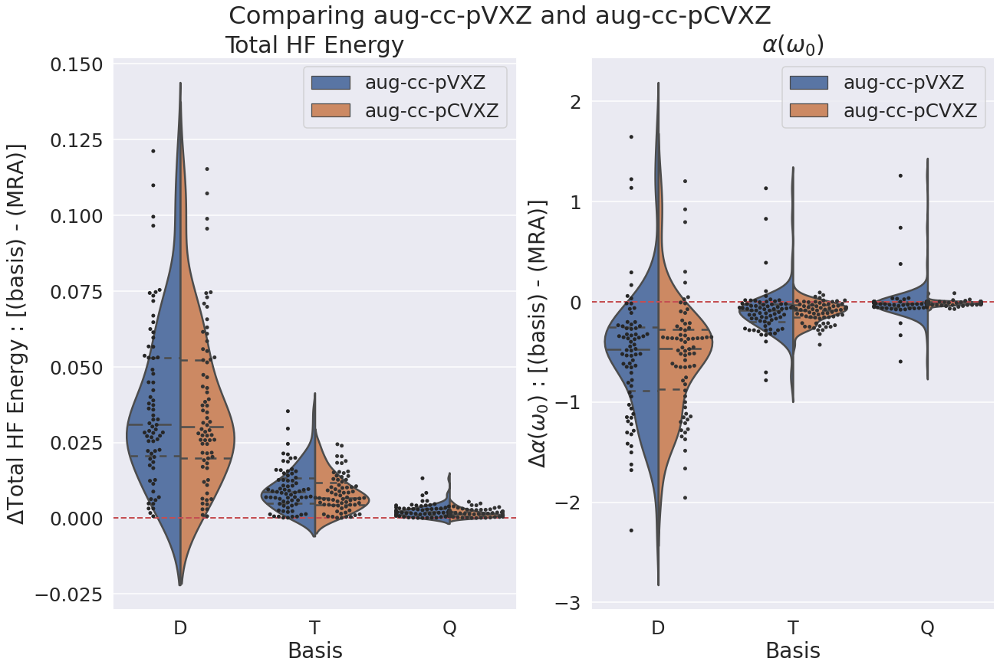

In [47]:

pc_aug_fig=polarization_series_violin_plots(data2,blist,pc_basis_list)
pc_aug_fig.savefig('acs_plots_new/violin_aug_polarized_core.svg')


/tmp/ipykernel_10415/426774053.py:75: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d2.loc[:,'basis']=base_vals
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 35.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 47.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/adrianhurtado/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the

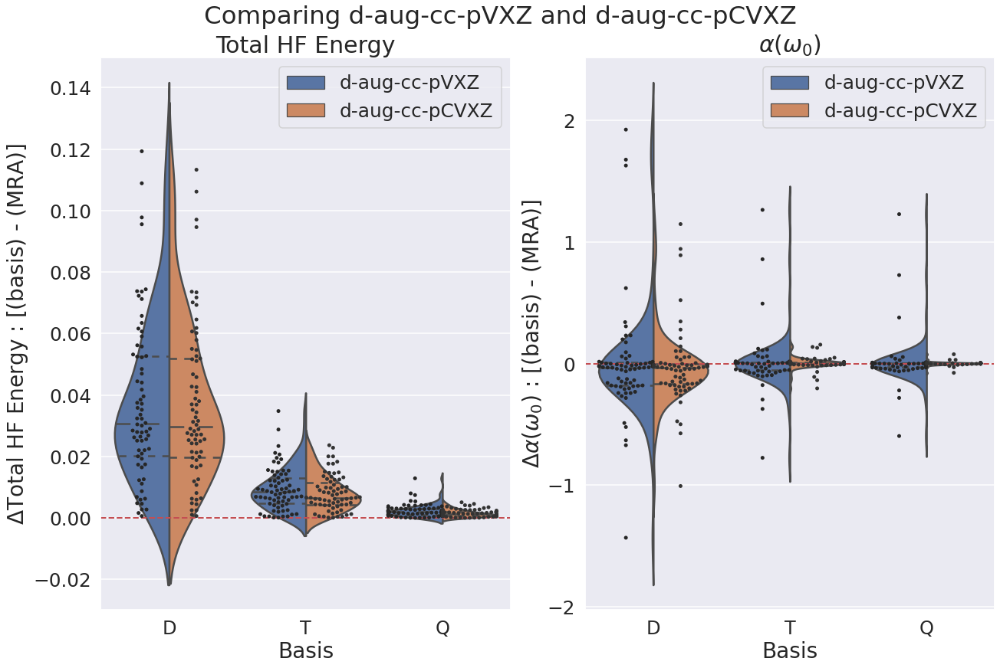

In [48]:

pc_aug_fig=polarization_series_violin_plots(data2,dlist,dpc_basis_list)
pc_aug_fig.savefig('acs_plots_new/violin_daug_polarized_core.svg')

In [ ]:
# plottting and dataframes related to std and mean of data
def mean_std_basis(basis,data):
    
    dm=data.loc[data.basis==basis]
    basis_mean=dm.mean()
    basis_std=dm.std()
    
    return basis_mean,basis_std

def mean_std_basis_df(basis_list,data):
    
    mean_dict={}
    std_dict={}
    for basis in basis_list:
        
        [mean_dict[basis],std_dict[basis]]=mean_std_basis(basis,data)
    
    mean_df=pd.DataFrame(mean_dict)
    std_df=pd.DataFrame(std_dict)
    
    polar_mean=mean_df.loc[mean_df.index[1:]]
    polar_std=std_df.loc[std_df.index[1:]]
    
    total_e_mean=mean_df.loc[mean_df.index[0:1]]
    total_e_std=std_df.loc[std_df.index[0:1]]
    
    return polar_mean,polar_std,total_e_mean,total_e_std


def plot_total_energy_basis_statistics(basis_list,total_e_mean,total_e_std):
    
    fig=plt.figure(constrained_layout=True,figsize=(20,10))
    fig.suptitle('Basis-Set Convergence')
    
    subfig=fig.subplots(nrows=1,ncols=2)
    
    axleft=subfig[0]
    axright=subfig[1]
    
    total_e_mean[basis_list].T.plot(ax=axleft,marker='*',title='Error in Total Energy')
    total_e_std[basis_list].T.plot(ax=axright,marker='*',title='Standard Error in Total Energy')



In [ ]:

def plot_stat(basis_list,data,data_title,ax):
    
    num_freq=len(list(data[basis_list].index))
    omega_label=[]
    for i in range(num_freq):
        #omega_label.append(r'$\omega_{}$'.format(i))
        omega_label.append(str(i))
        
    data[basis_list].plot(ax=ax,marker='o',title=data_title,lw=4,ms=20)
    xticks=[f for f in range(num_freq)]
    ax.set_xticks(xticks,labels=omega_label)
    ax.set_xlabel(r'$\omega_i$')
    
    if data_title=='Mean Error':
        ax.set_ylabel(r'$\Delta \alpha(\omega_i)$')
    elif data_title=='Standard Deviation Error':
        ax.set_ylabel(r'$\sigma$')
    
    ax.axhline(y=0,c='k',linestyle='--')
    
    return None

def plot_basis_statistic(basis_list,polar_mean,polar_std,data_name):
    
    sns.set_theme(style="darkgrid")
    sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 2.5})
    btitle=basis_list[0].replace('D','X')

    fig=plt.figure(constrained_layout=True,figsize=(20,10))
    fig.suptitle(r'Error in $\alpha(\omega)$: '+btitle+' '+data_name)
    subfig=fig.subplots(nrows=1,ncols=2)
    axleft=subfig[0]
    axright=subfig[1]
    
    plot_stat(basis_list,polar_mean,'Mean Error',axleft)
    plot_stat(basis_list,polar_std,'Standard Deviation Error',axright)
    
    return fig
    
def create_basis_stat_plot(blist,data,data_name):
    polar_mean,polar_std,total_e_mean,total_e_std=mean_std_basis_df(blist,data)
    return plot_basis_statistic(blist,polar_mean,polar_std,data_name) 



In [49]:

f=create_basis_stat_plot(blist,data1_keep,': X=DTQ')
f.savefig('acs_plots_new/freq_full_aug.svg')
f=create_basis_stat_plot(dlist,data1_keep,': X=DTQ')
f.savefig('acs_plots_new/freq_full_daug.svg')

NameError: name 'create_basis_stat_plot' is not defined

In [ ]:

f=create_basis_stat_plot(blist5,data3,': X=DTQ5')
f.savefig('acs_plots_new/freq_5_aug.svg')
f=create_basis_stat_plot(dlist5,data3,': X=DTQ5')
f.savefig('acs_plots_new/freq_5_daug.svg')


In [ ]:

f=create_basis_stat_plot(pc_basis_list,data2,': X=DTQ')
f.savefig('acs_plots_new/freq_pc_aug.svg')
f=create_basis_stat_plot(dpc_basis_list,data2,': X=DTQ')
f.savefig('acs_plots_new/freq_pc_daug.svg')

In [ ]:

def plot_freq_stat(basis_list,data,data_title,ax):
    
    num_freq=len(list(data[basis_list].index))
    omega_label=[]
    for i in range(num_freq):
        omega_label.append(r'$\omega_{}$'.format(i))
        
    data[basis_list].T.plot(ax=ax,marker='o',title=data_title,lw=4,ms=20,colormap='magma')
    ax.set_xlabel(r'Basis')
    
    ax.legend(labels=omega_label)
    
    if data_title=='Mean Error':
        ax.set_ylabel(r'$\Delta \alpha(\omega_i)$')
    elif data_title=='Standard Deviation Error':
        ax.set_ylabel(r'$\sigma$')
    
    ax.axhline(y=0,c='k',linestyle='--')
    

def plot_basis_stat(basis_list,polar_mean,polar_std,data_name):
    
    btitle=basis_list[0].replace('D','X')
    fig=plt.figure(constrained_layout=True,figsize=(24,11))
    
    fig.suptitle(r'Error in $\alpha(\omega)$: '+btitle+' '+data_name)
    
    subfig=fig.subplots(nrows=1,ncols=2)
    
    axleft=subfig[0]
    axright=subfig[1]
    
    plot_freq_stat(basis_list,polar_mean,'Mean Error',axleft)
    plot_freq_stat(basis_list,polar_std,'Standard Deviation Error',axright)
    
    return fig

def create_basis_freq_plot(blist,data,data_name):
    polar_mean,polar_std,total_e_mean,total_e_std=mean_std_basis_df(blist,data)
    return plot_basis_stat(blist,polar_mean,polar_std,data_name) 


In [ ]:

p1=create_basis_freq_plot(blist,data,'Full') 
p1.savefig('acs_plots/aug_error_full.svg')
p1=create_basis_freq_plot(blist,keep,'Clean') 
p1.savefig('acs_plots/aug_error_keep.svg')
p1=create_basis_freq_plot(blist,remove,'Outlier') 
p1.savefig('acs_plots/aug_error_remove.svg')

p1=create_basis_freq_plot(dlist,data,'Full') 
p1.savefig('acs_plots/daug_error_full.svg')
p1=create_basis_freq_plot(dlist,keep,'Clean') 
p1.savefig('acs_plots/daug_error_keep.svg')
p1=create_basis_freq_plot(dlist,remove,'Outlier') 
p1.savefig('acs_plots/daug_error_remove.svg')

In [ ]:
data_keys=list(data.keys())
polar_only=[data_keys[0]]+data_keys[2:]
alpha_keys=polar_only[1:-1]
f_data=data.loc[:,polar_only]
f_data
num_points=len(f_data)

basis_series=f_data.loc[:,'basis']

seperated=[]
i=0
for omega in alpha_keys:
    a_omega=f_data.loc[:,['molecule',omega,'basis']]
    a_omega=a_omega.rename(columns={omega:r'$\alpha$'})
    freq_series=pd.Series([int(i) for j in range(num_points)])
    freq_series.index=a_omega.index
    freq_series.name='frequency'
    i+=1
    seperated.append(pd.concat([a_omega,freq_series],axis=1))
    
    
    
fdata=pd.concat(seperated)
fdata

In [ ]:
list[f_data.keys()[0:-1]]

In [ ]:
f1=series_violin_plots(full_pc_data,pc_basis_list,dpc_basis_list)
f1.savefig('acs_plots/violin-pc_full.svg')

In [ ]:
pc_data_aug=create_basis_set_df(blist+pc_basis_list,pc_mols,9)
pc_data_daug=create_basis_set_df(dlist+dpc_basis_list,pc_mols,9)



In [ ]:

pc_aug_fig=polarization_series_violin_plots(pc_data_aug,blist,pc_basis_list)
pc_aug_fig.savefig('acs_plots/violin-pc_aug.svg')
dpc_aug_fig=polarization_series_violin_plots(pc_data_daug,dlist,dpc_basis_list)
dpc_aug_fig.savefig('acs_plots/violin-dpc_daug.svg')

In [ ]:

f1=compare_bar_plots(data,'aug-cc-pVQZ','d-aug-cc-pVQZ',data_keys[1])
f1.savefig('acs_plots/bar_e0_aug.svg')
f2=compare_bar_plots(data,'aug-cc-pVQZ','d-aug-cc-pVQZ',data_keys[2])
f2.savefig('acs_plots/bar_w0_aug.svg')
f10=compare_bar_plots(data,'aug-cc-pVQZ','d-aug-cc-pVQZ',data_keys[10])
f10.savefig('acs_plots/bar_wmax_aug.svg')

In [ ]:
f1=compare_bar_plots(full_pc_data,'aug-cc-pCVQZ','d-aug-cc-pCVQZ',data_keys[1])
f1.savefig('acs_plots/bar_e0_augPC.svg')
f2=compare_bar_plots(full_pc_data,'aug-cc-pCVQZ','d-aug-cc-pCVQZ',data_keys[2])
f2.savefig('acs_plots/bar_w0_augPC.svg')
f10=compare_bar_plots(full_pc_data,'aug-cc-pCVQZ','d-aug-cc-pCVQZ',data_keys[10])
f10.savefig('acs_plots/bar_wmax_augPC.svg')

In [ ]:
full_basis_df=create_basis_set_df(blist+dlist+pc_basis_list+dpc_basis_list,pc_mols,9)


f1=compare_bar_plots(full_basis_df,'d-aug-cc-pVQZ','d-aug-cc-pCVQZ',data_keys[1])
f1.savefig('acs_plots/bar_e0_noPCvsPC.svg')
f2=compare_bar_plots(full_basis_df,'d-aug-cc-pVQZ','d-aug-cc-pCVQZ',data_keys[2])
f2.savefig('acs_plots/bar_w0_noPCvsPC.svg')
f10=compare_bar_plots(full_basis_df,'d-aug-cc-pCVQZ','d-aug-cc-pCVQZ',data_keys[10])
f10.savefig('acs_plots/bar_wmax_noPCvsPC.svg')

In [ ]:
all_mols

In [5]:
d=ExcitedData('He','hf')

KeyError: 'density_residuals'

In [4]:

def __read_response_protocol_data(self, protocol_data: json, num_states, num_orbitals):

    num_protocols = protocol_data.__len__()
    dcol = []
    xcol = []
    ycol = []
    for i in range(num_states):
        dcol.append("d" + str(i))
        xcol.append("x" + str(i))
        ycol.append("y" + str(i))
    polar_dfs = []
    residual_dfs = []

    bsh_norms_dfs = []
    d_norms_dfs = []

    protos = []
    kprotos = []
    iters = []
    iter_p = 0
    num_iters_per_protocol = []
    for proto in protocol_data:
        protos.append(proto["proto"])
        kprotos.append(proto["k"])
        num_iters = proto["iter_data"].__len__()
        num_iters_per_protocol.append(num_iters)

        proto_array = np.ones((num_iters, 1)) * proto["proto"]
        kproto_array = np.ones((num_iters, 1)) * proto["k"]
        polar_data = np.empty((num_iters, 9))

        dres = np.empty((num_iters, num_states))

        x_norms = np.empty((num_iters, num_states))
        abs_x_norms = np.empty((num_iters, num_states))
        rel_x_norms = np.empty((num_iters, num_states))
        xi_res_norms = np.empty((num_iters, num_states * 2 * num))

        rho_norms = np.empty((num_iters, num_states))
        rho_residual_norms = np.empty((num_iters, num_states))

        chi_y_norms = np.empty((num_iters, 3))
        rho_norms = np.empty((num_iters, 3))

        i = 0
        for iter in proto["iter_data"]:
            # diagonalize the polarizability
            alpha = self.__tensor_to_numpy(iter["polar"]).flatten()
            # alpha=.5*(alpha+alpha.transpose())
            # w, v = LA.eig(alpha)
            # print("alpha : ",alpha)
            polar_data[i, :] = alpha

            dres[i, :] = self.__tensor_to_numpy(iter["density_residuals"]).flatten()
            xres[i, :] = self.__tensor_to_numpy(iter["res_X"]).flatten()
            yres[i, :] = self.__tensor_to_numpy(iter["res_Y"]).flatten()

            chi_x_norms[i, :] = self.__tensor_to_numpy(iter["chi_norms_x"]).flatten()
            chi_y_norms[i, :] = self.__tensor_to_numpy(iter["chi_norms_y"]).flatten()
            rho_norms[i, :] = self.__tensor_to_numpy(iter["rho_norms"]).flatten()

            i += 1
            iters.append(iter_p)
            iter_p += 1
        kproto_df = pd.DataFrame(kproto_array, columns=["k"])
        proto_df = pd.DataFrame(proto_array, columns=["thresh"])
        polar_df = pd.DataFrame(
            polar_data,
            columns=["xx", "xy", "xz", "yx", "yy", "yz", "zx", "zy", "zz"],
        )
        polar_df = pd.concat([kproto_df, proto_df, polar_df], axis=1)
        dres_df = pd.DataFrame(dres, columns=dcol)
        xres_df = pd.DataFrame(xres, columns=xcol)
        yres_df = pd.DataFrame(yres, columns=ycol)

        rho_norms_df = pd.DataFrame(rho_norms, columns=dcol)

        chi_x_norms_df = pd.DataFrame(chi_x_norms, columns=xcol)
        chi_y_norms_df = pd.DataFrame(chi_y_norms, columns=ycol)

        bsh_norms_df = pd.concat([chi_x_norms_df, chi_y_norms_df], axis=1)

        residuals_df = pd.concat(
            [kproto_df, proto_df, dres_df, xres_df, yres_df], axis=1
        )
        polar_dfs.append(polar_df)
        residual_dfs.append(residuals_df)

        d_norms_dfs.append(rho_norms_df)
        bsh_norms_dfs.append(bsh_norms_df)

    iters_df = pd.DataFrame(iters, columns=["iterations"])
    final_polar = pd.concat(polar_dfs, ignore_index=True)
    final_res = pd.concat(residual_dfs, ignore_index=True)
    final_polar = pd.concat([iters_df, final_polar], axis=1)
    final_res = pd.concat([iters_df, final_res], axis=1)
    final_d_norms = pd.concat(d_norms_dfs, ignore_index=True)
    final_bsh_norms = pd.concat(bsh_norms_dfs, ignore_index=True)

    return final_polar, final_res, num_iters_per_protocol, final_d_norms, final_bsh_norms